In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import importlib

#system
from pathlib import Path
import time

#ai
import torch
from torch import nn
import torchvision
from torch.utils.data import TensorDataset, DataLoader

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

import src
importlib.reload(src)

import src.utils.metrics as metrics
import src.utils.gau as gaussian
import src.utils.plots as plots

from src.models import AE, RNN, LinearClassifier, get_latent_features, rnn_loss_function, ae_loss_function
from src.training import EarlyStopping, train_ae, train_rnn, train_lp, augment_data

from src.final_model import ae_loss_function, rnn_loss_function

c:\Users\pmarc\.conda\envs\inteli_gpu\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
stamps_dataset = pd.read_pickle('data/5stamps_dataset.pkl')

def rename_labels(dataset, old_value, new_value):
    for key in dataset.keys():
        if old_value in dataset[key]:
            dataset[key][new_value] = dataset[key].pop(old_value)

rename_labels(stamps_dataset, 'labels', 'class')
rename_labels(stamps_dataset, 'science', 'images')

In [ ]:
train_template = torch.tensor(stamps_dataset['Train']['template'], dtype=torch.float32)
validation_template = torch.tensor(stamps_dataset['Validation']['template'], dtype=torch.float32)
test_template = torch.tensor(stamps_dataset['Test']['template'], dtype=torch.float32)

train_difference = torch.tensor(stamps_dataset['Train']['difference'], dtype=torch.float32)
validation_difference = torch.tensor(stamps_dataset['Validation']['difference'], dtype=torch.float32)
test_difference = torch.tensor(stamps_dataset['Test']['difference'], dtype=torch.float32)

train_image = torch.tensor(stamps_dataset['Train']['images'], dtype=torch.float32)
validation_image = torch.tensor(stamps_dataset['Validation']['images'], dtype=torch.float32)
test_image = torch.tensor(stamps_dataset['Test']['images'], dtype=torch.float32)

train_class_0 = torch.tensor(stamps_dataset['Train']['class'], dtype=torch.float32)
validation_class_0 = torch.tensor(stamps_dataset['Validation']['class'], dtype=torch.float32)
test_class_0 = torch.tensor(stamps_dataset['Test']['class'], dtype=torch.float32)

train_template = train_template.unsqueeze(1).repeat(1, 5, 1, 1)
validation_template = validation_template.unsqueeze(1).repeat(1, 5, 1, 1)
test_template = test_template.unsqueeze(1).repeat(1, 5, 1, 1)


train_dataset = torch.stack((train_template, train_image, train_difference), dim=3  )
validation_dataset = torch.stack((validation_template, validation_difference, validation_difference), dim=3)
test_dataset = torch.stack((test_template, test_image, test_difference), dim=3)

train_template = train_template.unsqueeze(2)  # (samples, 5, 1, 21, 21)
train_image = train_image.unsqueeze(2)        
train_difference = train_difference.unsqueeze(2)  

validation_template = validation_template.unsqueeze(2)
validation_image = validation_image.unsqueeze(2)
validation_difference = validation_difference.unsqueeze(2)

test_template = test_template.unsqueeze(2)
test_image = test_image.unsqueeze(2)
test_difference = test_difference.unsqueeze(2)

# Apilar los tensores a lo largo de la dimensión correcta
train_dataset = torch.cat((train_template, train_image, train_difference), dim=2)
validation_dataset = torch.cat((validation_template, validation_image, validation_difference), dim=2)
test_dataset = torch.cat((test_template, test_image, test_difference), dim=2)

# Crear los conjuntos de datos
train_dataset = TensorDataset(train_dataset, train_class_0)
validation_dataset = TensorDataset(validation_dataset, validation_class_0)
test_dataset = TensorDataset(test_dataset, test_class_0)

In [ ]:
import src.final_model as fm
import src.final_training as ft
importlib.reload(fm)
importlib.reload(ft)
importlib.reload(src.final_training)
importlib.reload(src.final_model)

######################## DEFINIR OUTPUT DE IMAGENES #######################
import os
output_directory = 'experimentos_outputs'
os.makedirs(output_directory, exist_ok=True)
file_path = os.path.join(output_directory, 'experiment_results.txt')



###########################################################################
ae_loss = ae_loss_function
rnn_loss = rnn_loss_function

# Definicion de experimentos
experimentos_0 = [{'iteration' : '0_1', 'rnn_type' : 'LSTM', 'hidden_dim' : 21, 'num_layers' : 1, 'latent_dim' : 21, 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-5, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35,
                'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '0_2', 'rnn_type' : 'LSTM', 'hidden_dim' : 50, 'num_layers' : 1, 'latent_dim' : 50, 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-5, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '0_3', 'rnn_type' : 'LSTM', 'hidden_dim' : 70, 'num_layers' : 1, 'latent_dim' : 70, 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-5, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '0_4', 'rnn_type' : 'LSTM', 'hidden_dim' : 128, 'num_layers' : 1, 'latent_dim' : 128, 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-5, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]

i=1
best_lat = ('0_0', 0, 0)
for exp in experimentos_0:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_0)})\n")
    

    # ----- Entrenamiento de MLP
    curves_ae = ft.train_final_model(modelo,
                                                    'ae_rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_ae'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_lat[1]:
        best_lat = (modelo.name, precision_test, exp['latent_dim'])
        
    with open(file_path, 'a') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

experimentos_1 = [{'iteration' : '1_1', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-7, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35,
                'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '1_2', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-6, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '1_3', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : 10e-4, 'lr_rnn' : 10e-5, 'batch_size' : 128, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]       

plt.clf

In [ ]:
i=1
best_lr = ('0_0', 0, 0)
for exp in experimentos_1:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_1)})\n")
    

    # ----- Entrenamiento de MLP
    curves_ae = ft.train_final_model(modelo,
                                                    'ae_rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_ae'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_lr[1]:
        best_lr = (modelo.name, precision_test, exp['lr_ae'])

    with open(file_path, 'w') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

experimentos_2 = [{'iteration' : '2_1', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : 10e-8, 'batch_size' : 128, 'dropout' : 0.35,
                'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]       

plt.clf

C:\Users\pmarc\AppData\Local\Temp\ipykernel_9104\982257793.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  modelo.load_state_dict(torch.load(f'models/0_4.pth'))


Realizando experimento 2_1 (1/4)


Setup finishied. Starting training...
(0.01 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.15878718  - Train acc: 0.9445 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.13092064  - Train acc: 0.9564 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.12355461  - Train acc: 0.9576 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.12315021  - Train acc: 0.9573 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.12442601  - Train acc: 0.9558 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.12221145  - Train acc: 0.9550 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.12184358  - Train acc: 0.9551 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train loss: 

C:\Users\pmarc\AppData\Local\Temp\ipykernel_9104\982257793.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  modelo.load_state_dict(torch.load(f'models/0_4.pth'))


Realizando experimento 2_2 (1/4)


Setup finishied. Starting training...
(0.00 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.11273727  - Train acc: 0.9539 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.11705746  - Train acc: 0.9535 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.11769116  - Train acc: 0.9548 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.11093353  - Train acc: 0.9586 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.11187590  - Train acc: 0.9596 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.11601434  - Train acc: 0.9591 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.11536768  - Train acc: 0.9603 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train loss: 

C:\Users\pmarc\AppData\Local\Temp\ipykernel_9104\982257793.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  modelo.load_state_dict(torch.load(f'models/0_4.pth'))


Realizando experimento 2_3 (1/4)


Setup finishied. Starting training...
(0.00 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.32727019  - Train acc: 0.9039 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.27547663  - Train acc: 0.9095 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.25185175  - Train acc: 0.9163 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.23174298  - Train acc: 0.9219 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.22420935  - Train acc: 0.9229 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.22702170  - Train acc: 0.9190 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.22064964  - Train acc: 0.9216 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train loss: 

C:\Users\pmarc\AppData\Local\Temp\ipykernel_9104\982257793.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  modelo.load_state_dict(torch.load(f'models/0_4.pth'))


Realizando experimento 2_4 (1/4)


Setup finishied. Starting training...
(0.00 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 1.07575034  - Train acc: 0.3992 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 1.08776472  - Train acc: 0.3680 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 1.09197712  - Train acc: 0.3560 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 1.09436980  - Train acc: 0.3465 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 1.09515628  - Train acc: 0.3429 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 1.09608558  - Train acc: 0.3398 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 1.09673571  - Train acc: 0.3374 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train loss: 

c:\Users\pmarc\.conda\envs\inteli_gpu\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\pmarc\.conda\envs\inteli_gpu\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


<function matplotlib.pyplot.clf() -> 'None'>

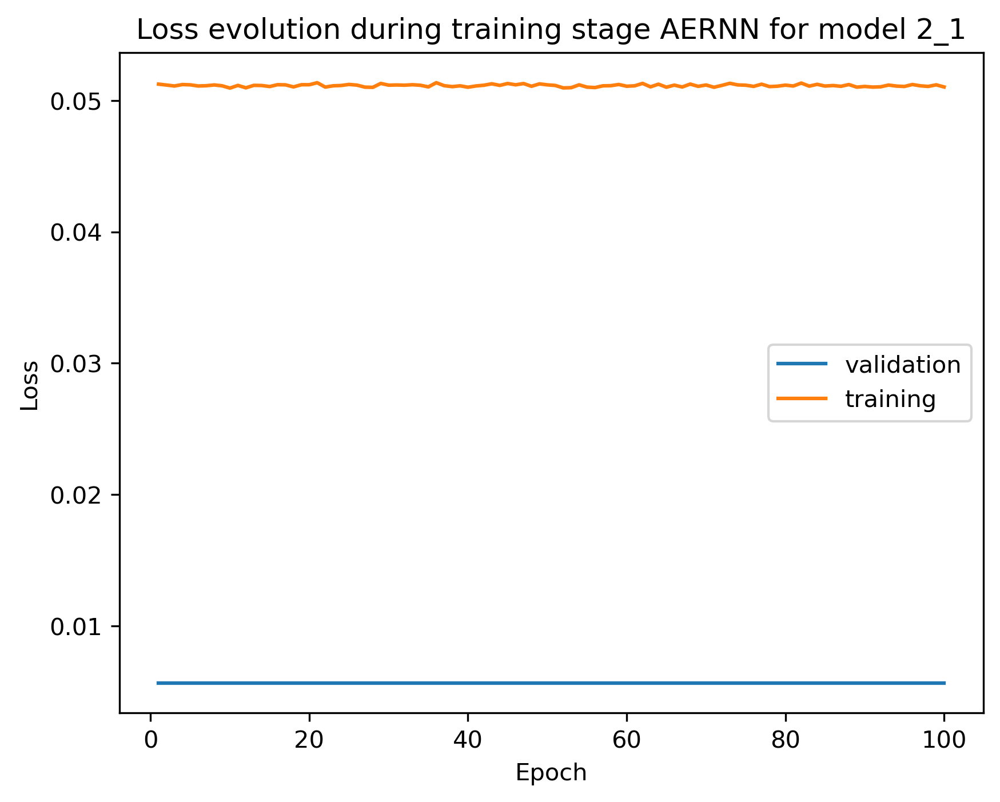

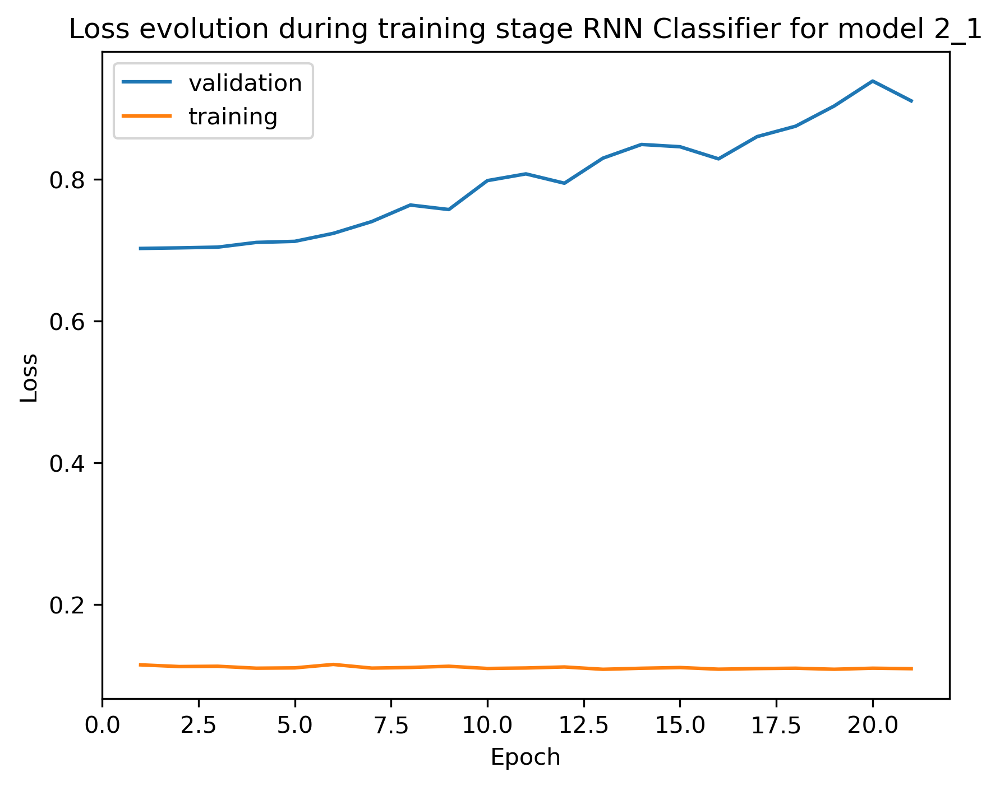

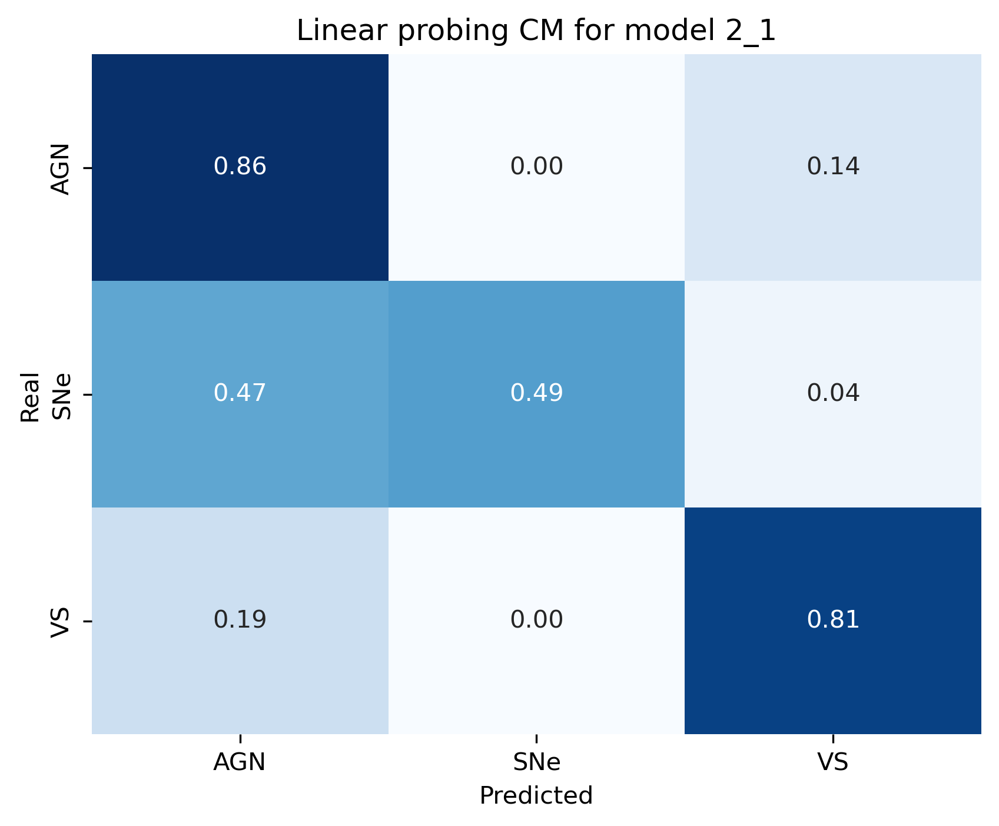

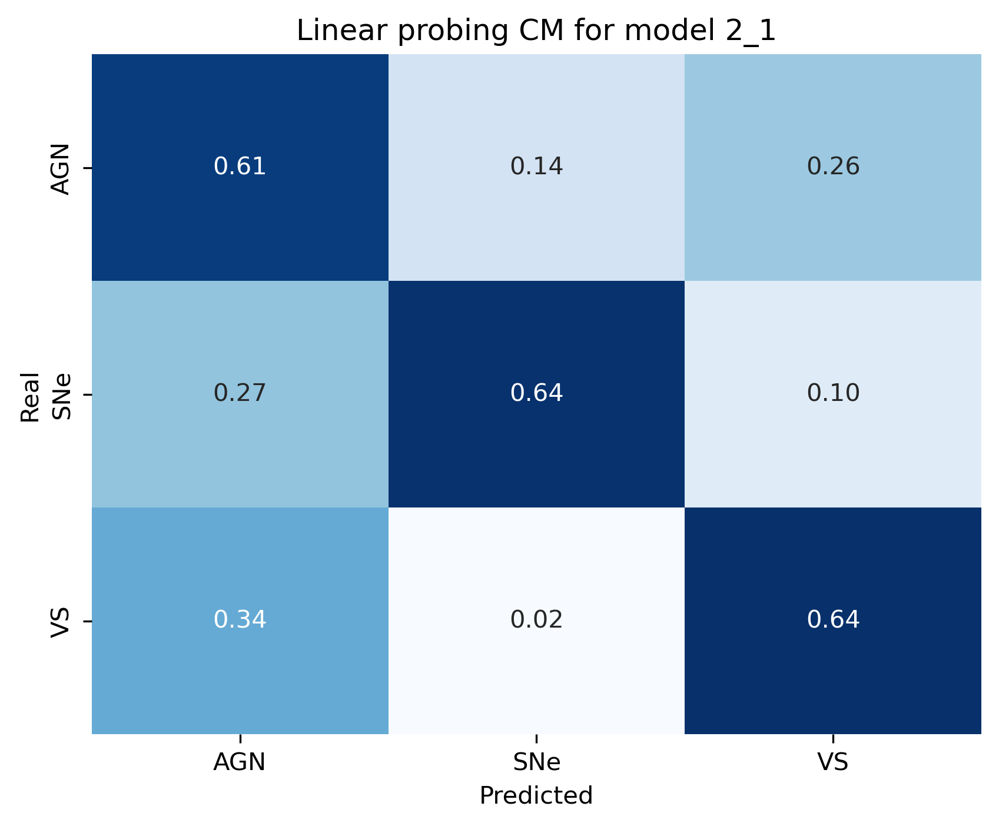

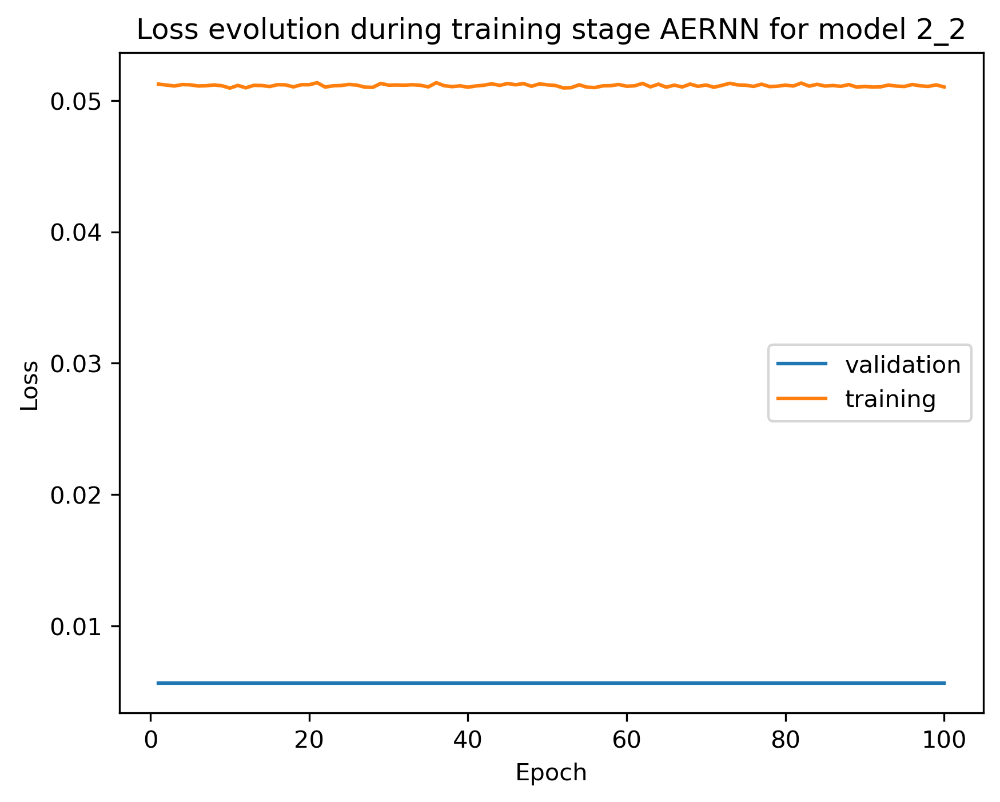

...

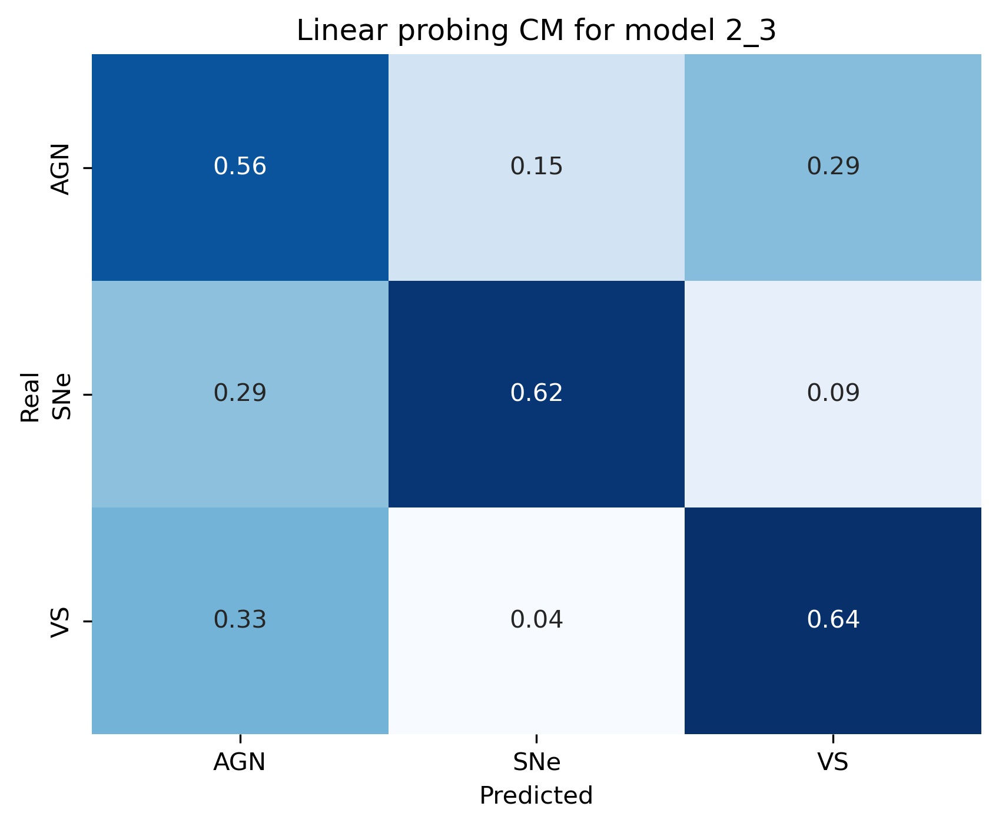

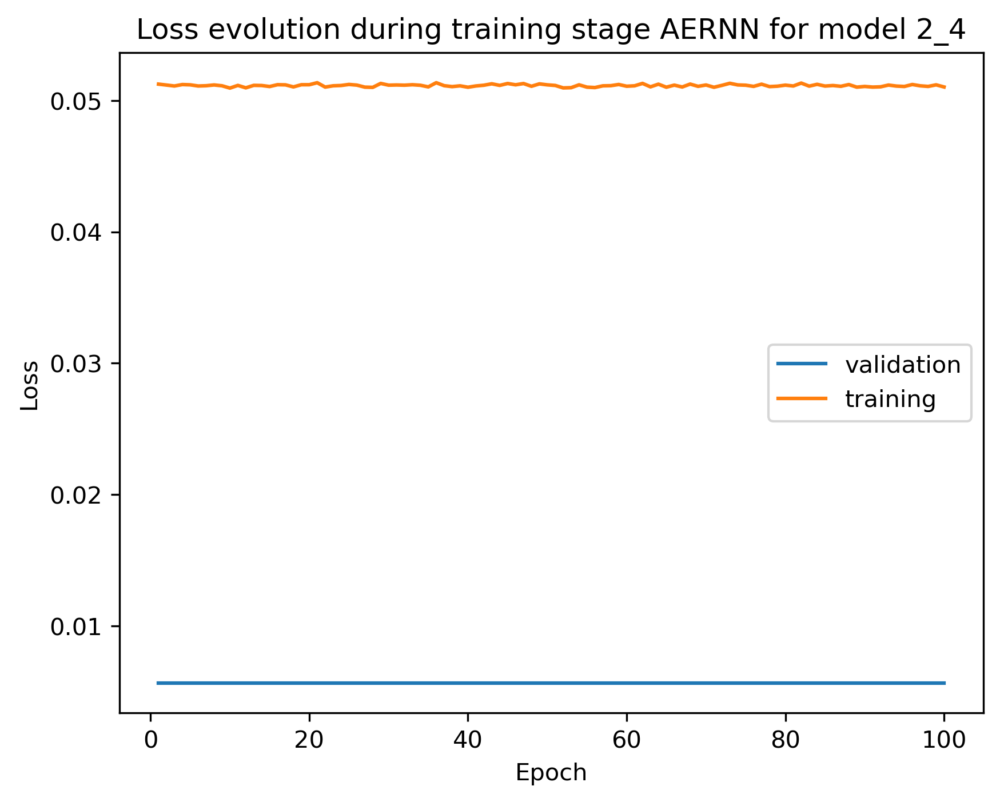

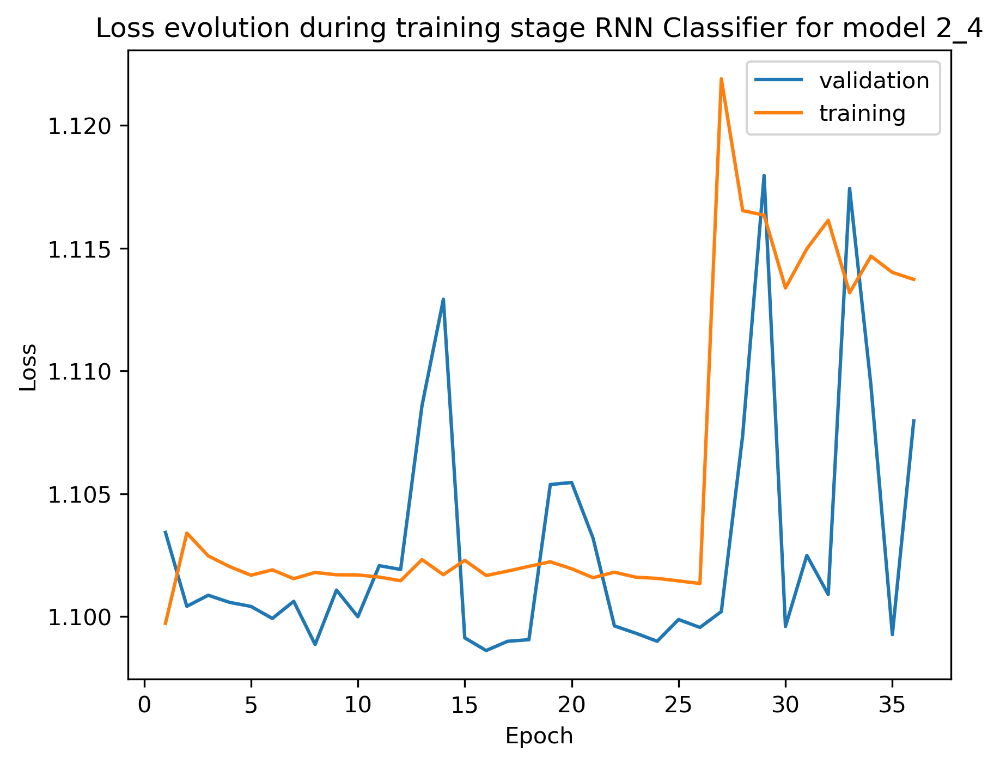

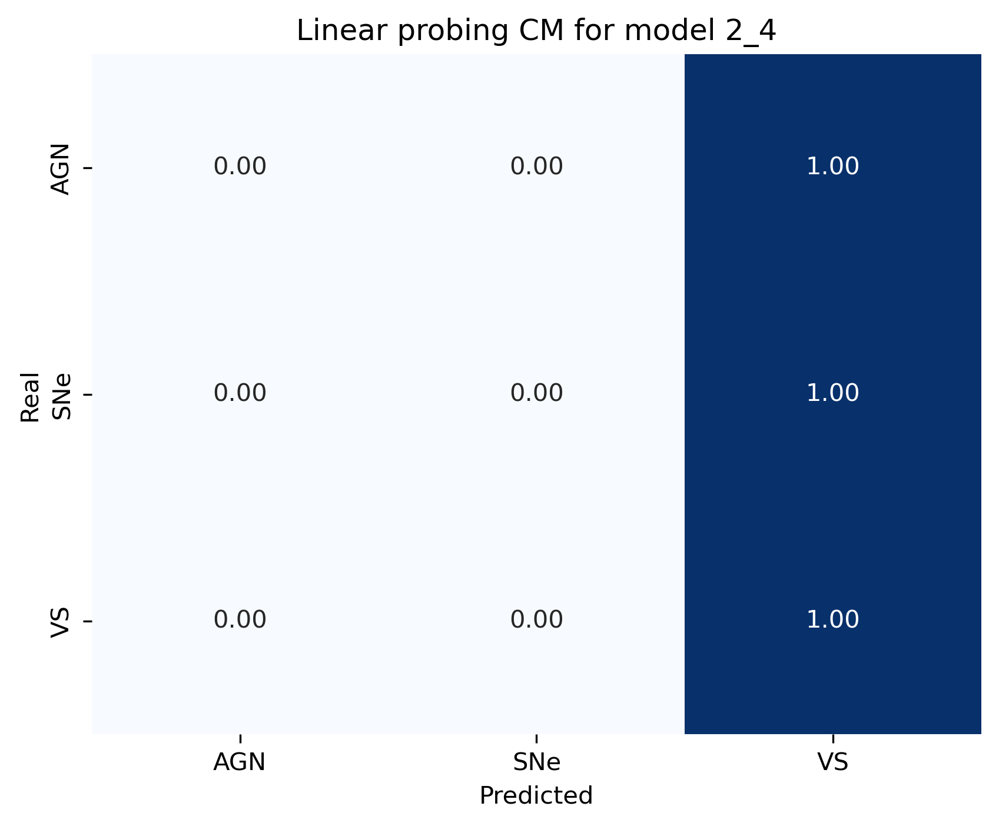

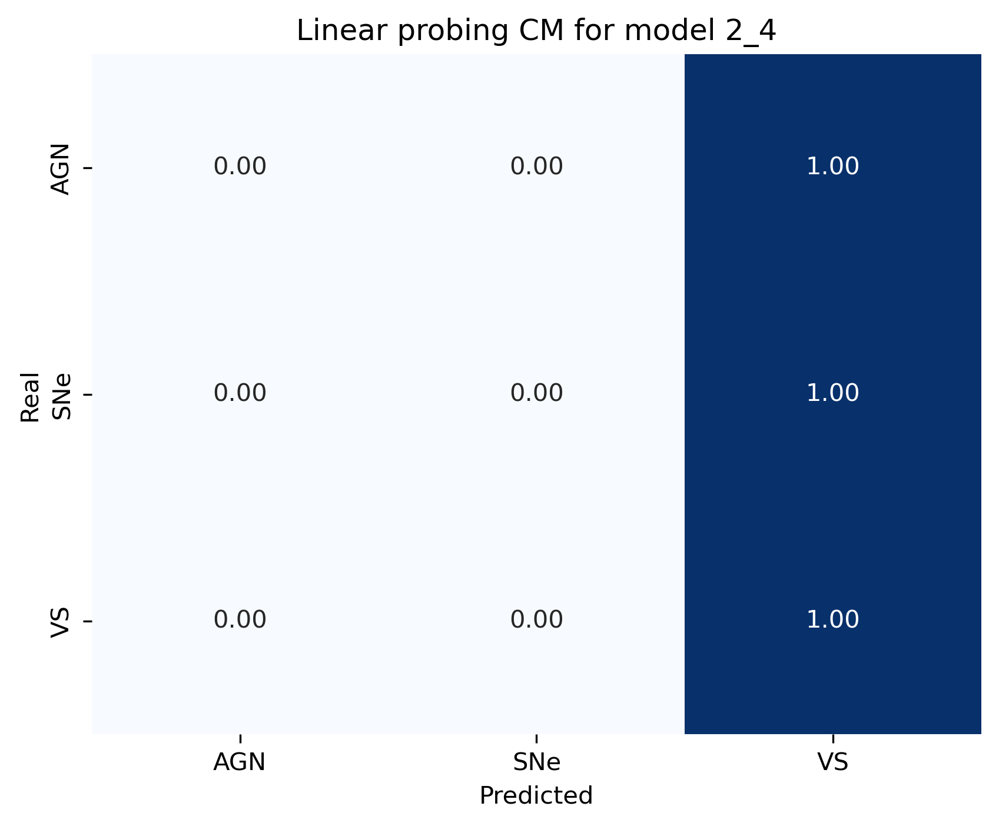

In [23]:
i=1
best_lr_rnn = ('0_0', 0, 10e-5)
for exp in experimentos_2:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    modelo.load_state_dict(torch.load(f'models/0_4.pth'))

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_2)})\n")
    

    # # ----- Entrenamiento de MLP
    # curves_ae = ft.train_final_model(modelo,
    #                                                 'ae_rnn',
    #                                                 train_dataset,
    #                                                 validation_dataset,
    #                                                 ae_loss,
    #                                                 rnn_loss,
    #                                                 exp['max_epochs'],
    #                                                 exp['max_time'],
    #                                                 exp['batch_size'],
    #                                                 exp['lr_ae'],
    #                                                 exp['random_sampler'],
    #                                                 exp['only_classifier'],
    #                                                 False,
    #                                                 exp['early_stop'],
    #                                                 exp['use_gpu'],
    #                                                 0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_lr_rnn[1]:
        best_lr_rnn = (modelo.name, precision_test, exp['lr_rnn'])

    with open(file_path, 'a') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

experimentos_3 = [{'iteration' : '3_1', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : 32, 'dropout' : 0.35,
                'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '3_2', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : 64, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '3_3', 'rnn_type' : 'LSTM', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : 256, 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]       

plt.clf

Realizando experimento 3_1 (1/3)


Setup finishied. Starting training...
(0.01 min) Epoch 1/100 -- Iteration 38 - Batch 38/3851 - Train loss: 0.06695068  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 76 - Batch 76/3851 - Train loss: 0.05863902  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 114 - Batch 114/3851 - Train loss: 0.05546633  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 152 - Batch 152/3851 - Train loss: 0.05361901  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 190 - Batch 190/3851 - Train loss: 0.05193916  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 228 - Batch 228/3851 - Train loss: 0.05067806  - Train acc: -0.0000 - Val loss: 0.00000000
(0.05 min) Epoch 1/100 -- Iteration 266 - Batch 266/3851 - Train loss: 0.04982181  - Train acc: -0.0000 - Val loss: 0.00000000
(0.06 min) Epoch 1/100 -- Iteration 304 - 

<function matplotlib.pyplot.clf() -> 'None'>

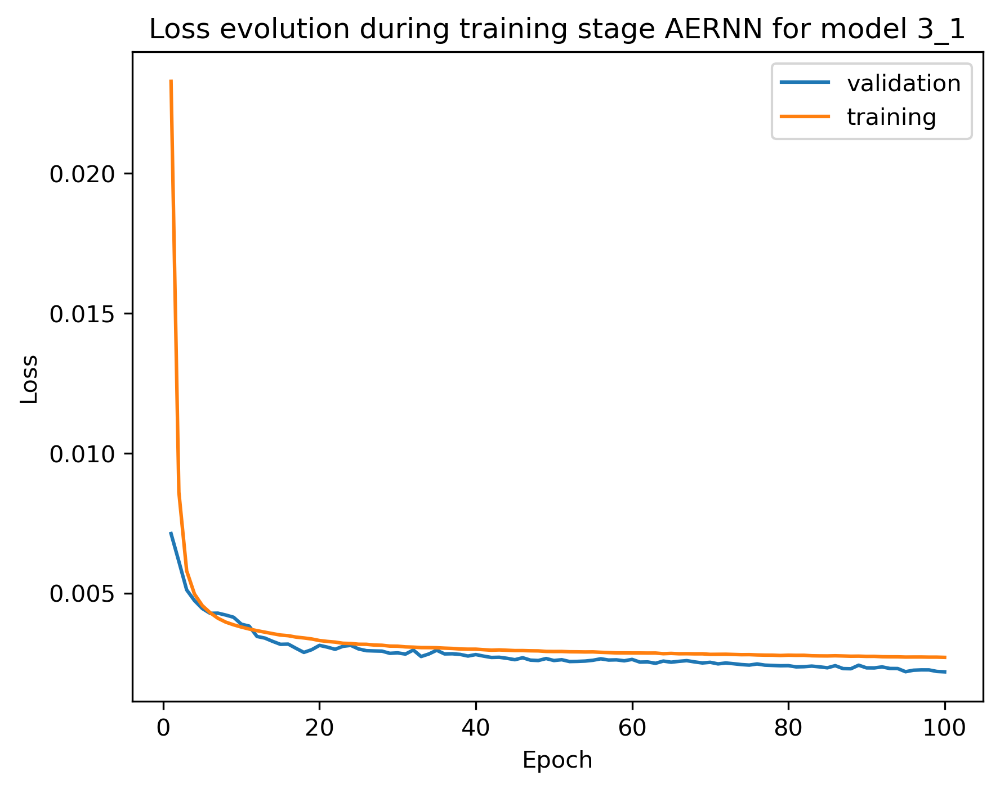

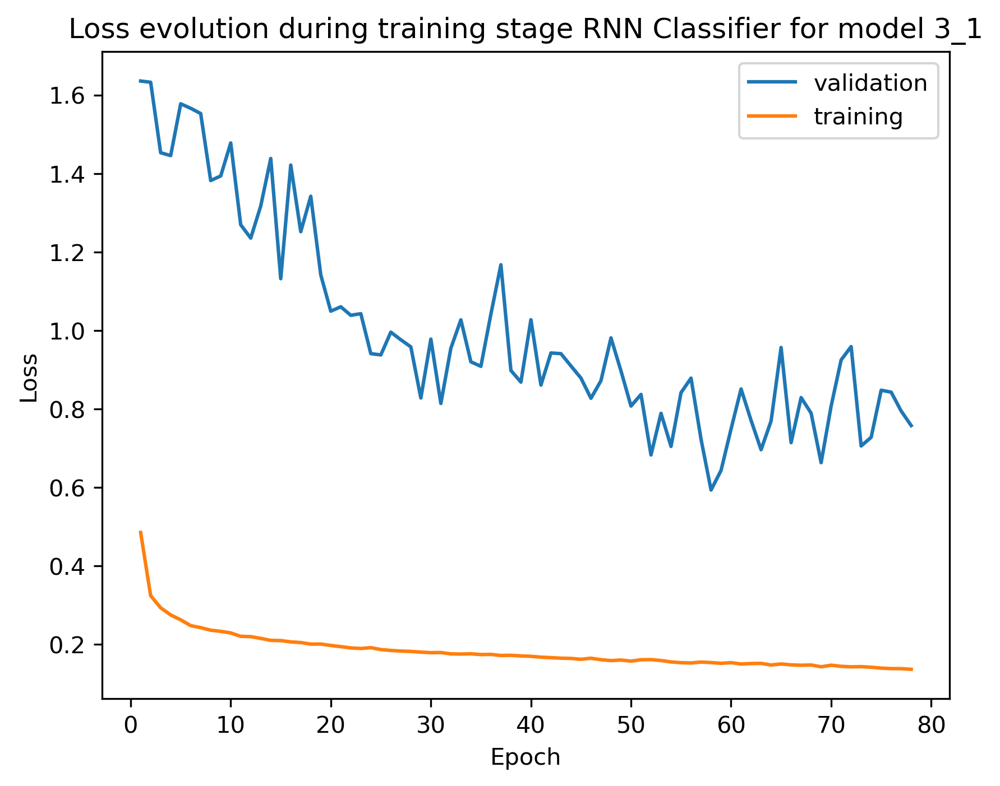

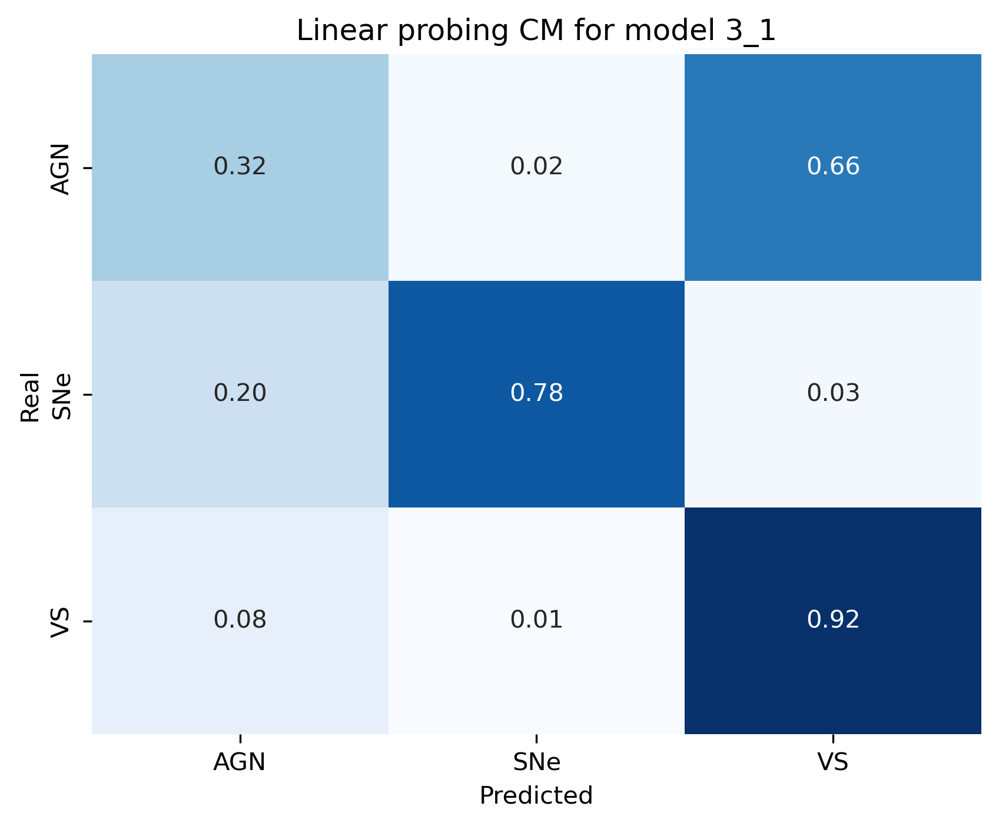

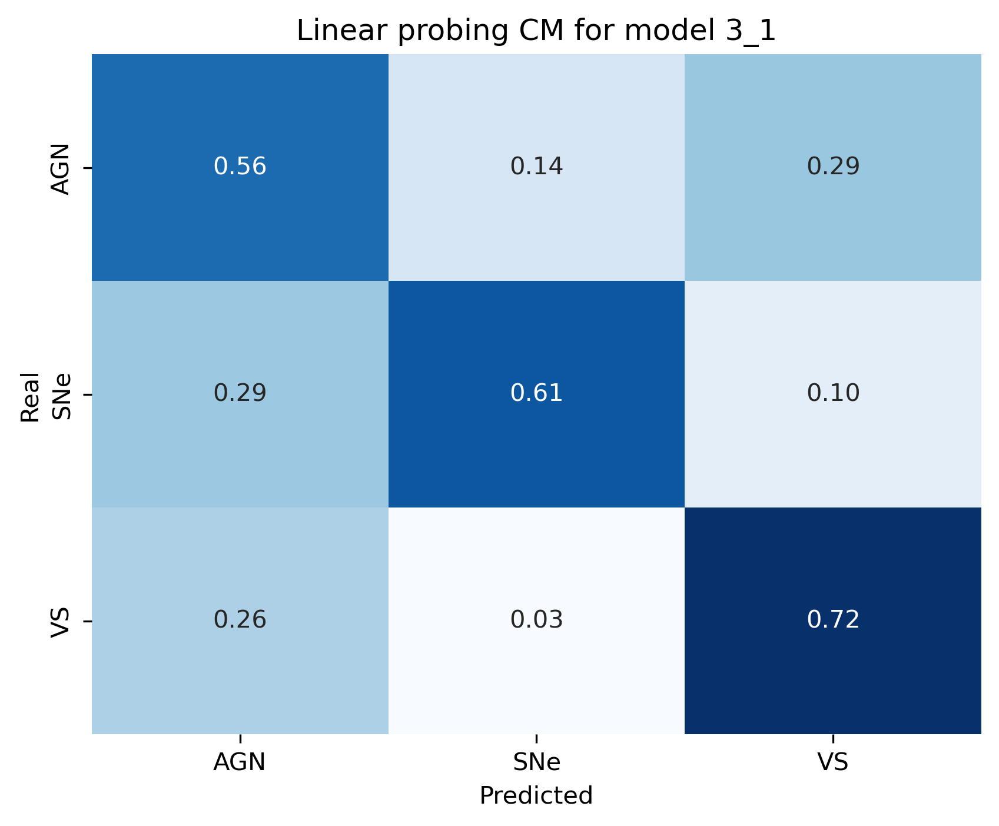

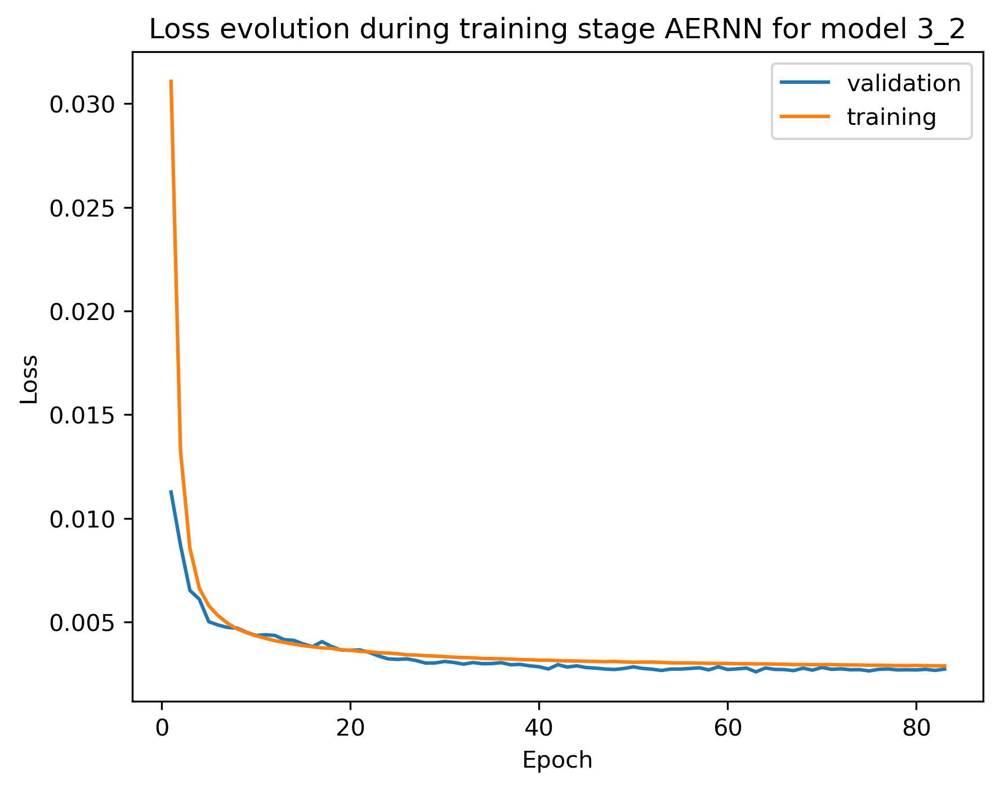

...

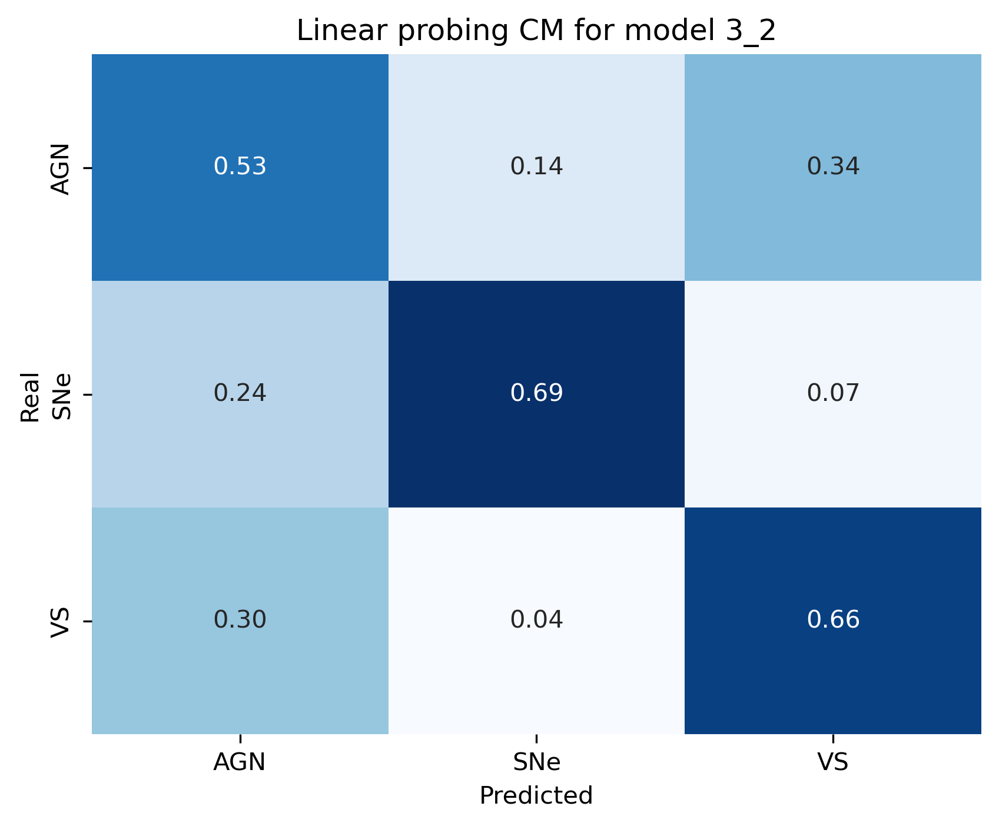

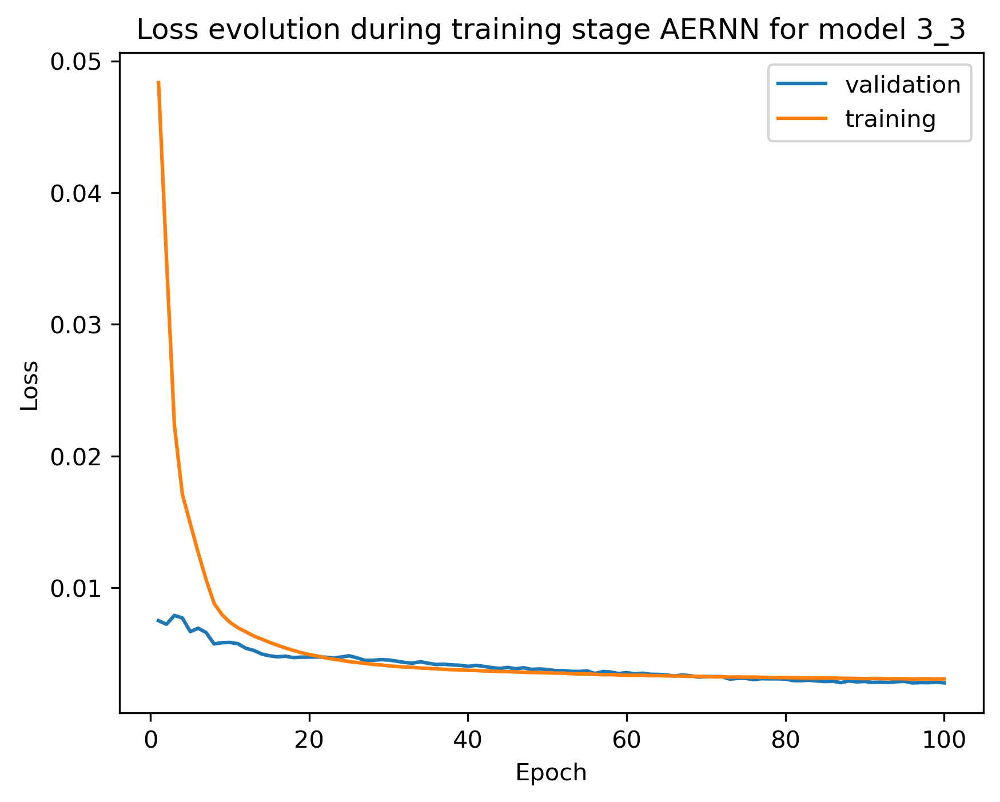

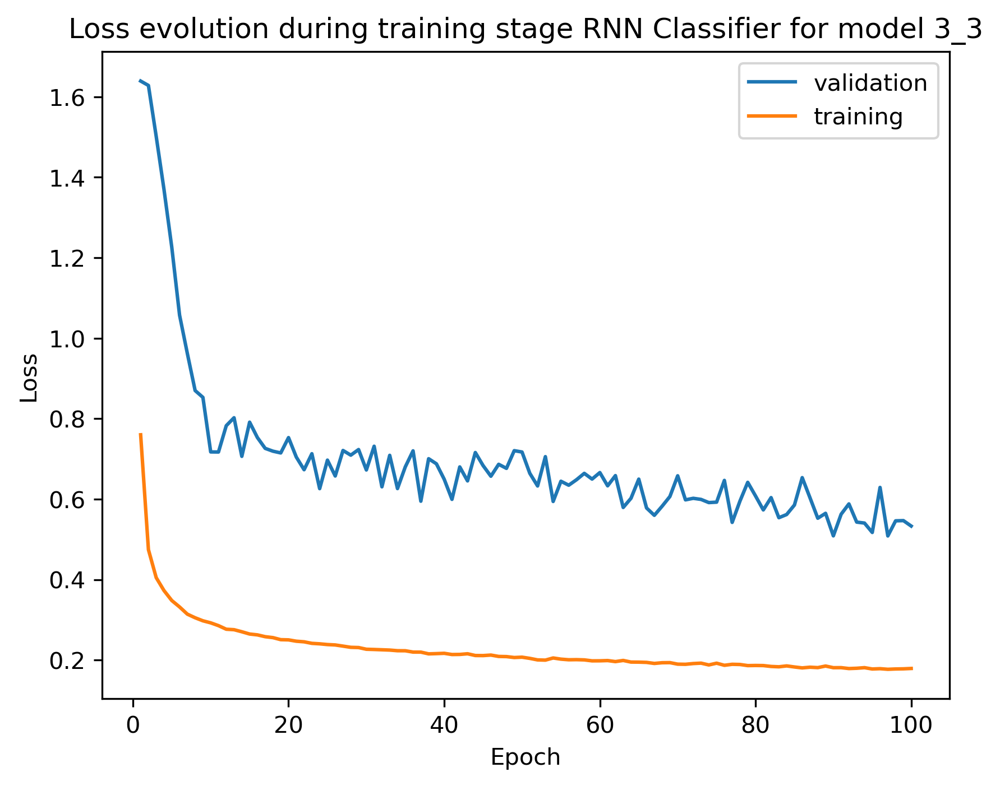

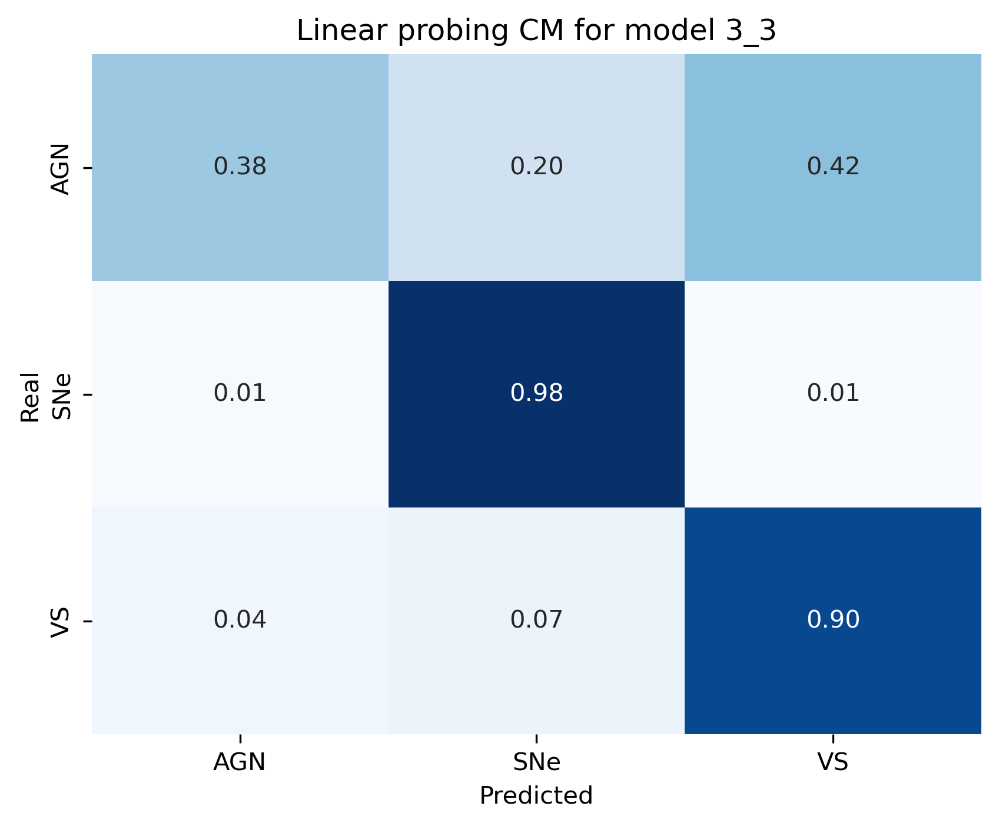

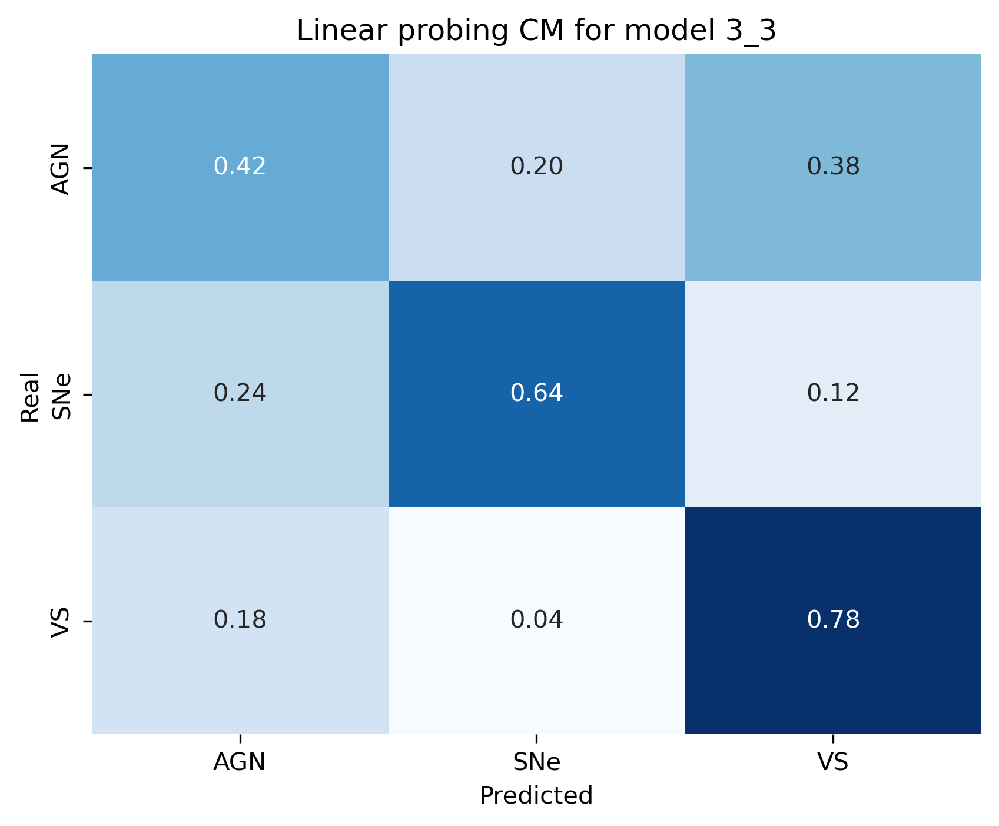

In [24]:
i=1
best_batch = ('0_0', best_lr_rnn[1], 128)
for exp in experimentos_3:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_3)})\n")
    

    # ----- Entrenamiento de MLP
    curves_ae = ft.train_final_model(modelo,
                                                    'ae_rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_ae'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_batch[1]:
        best_batch = (modelo.name, precision_test, exp['batch_size'])

    with open(file_path, 'a') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

experimentos_4 = [{'iteration' : '4_1', 'rnn_type' : 'RNN', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.35,
                'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '4_2', 'rnn_type' : 'GRU', 'hidden_dim' : best_lat[2], 'num_layers' : 1, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]       

plt.clf

Realizando experimento 4_1 (1/2)


Setup finishied. Starting training...
(0.01 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.17818246  - Train acc: -0.0000 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.15255412  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.13326726  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.11919399  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.10882818  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.10071526  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.09449903  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train

<function matplotlib.pyplot.clf() -> 'None'>

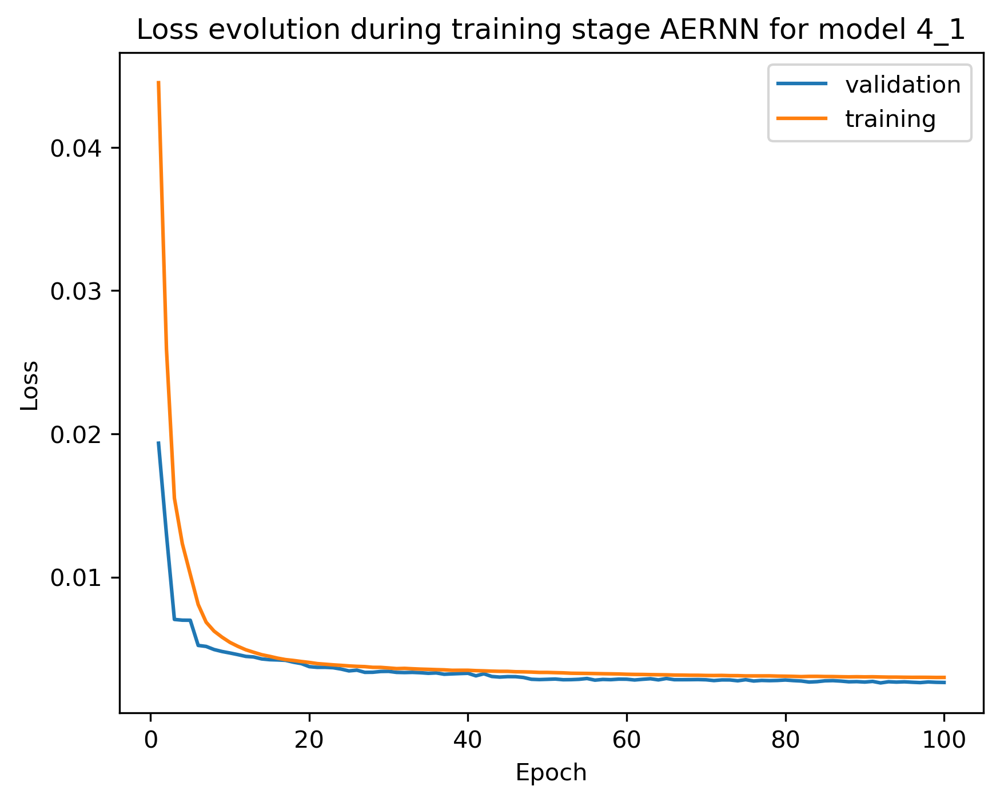

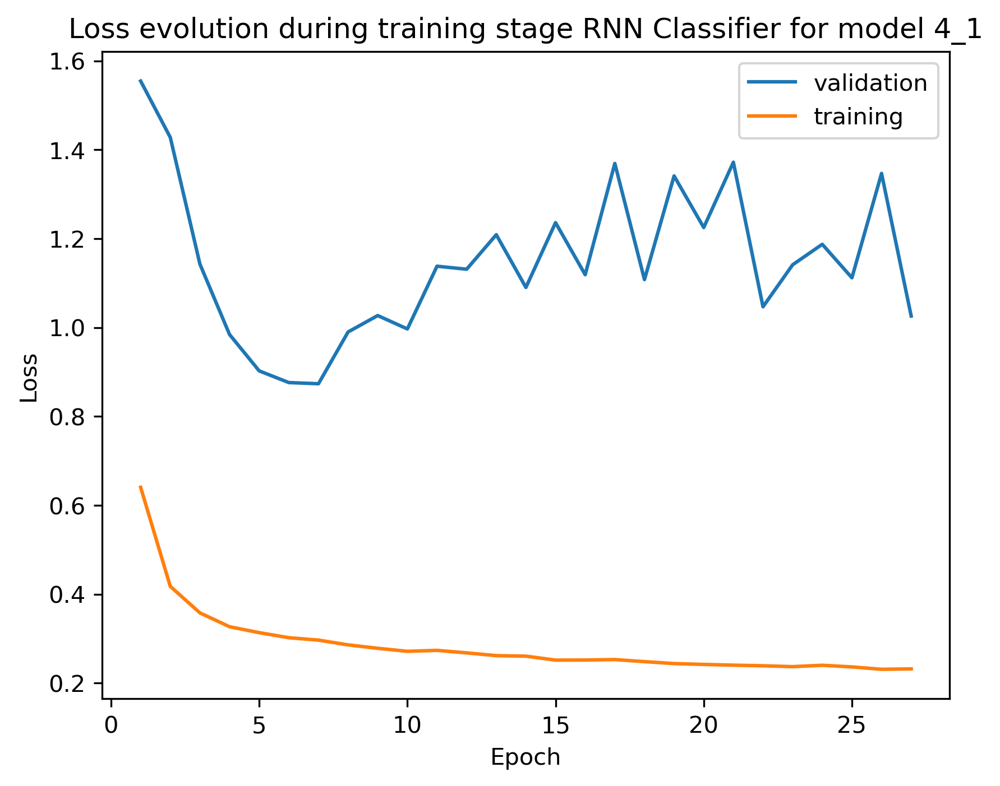

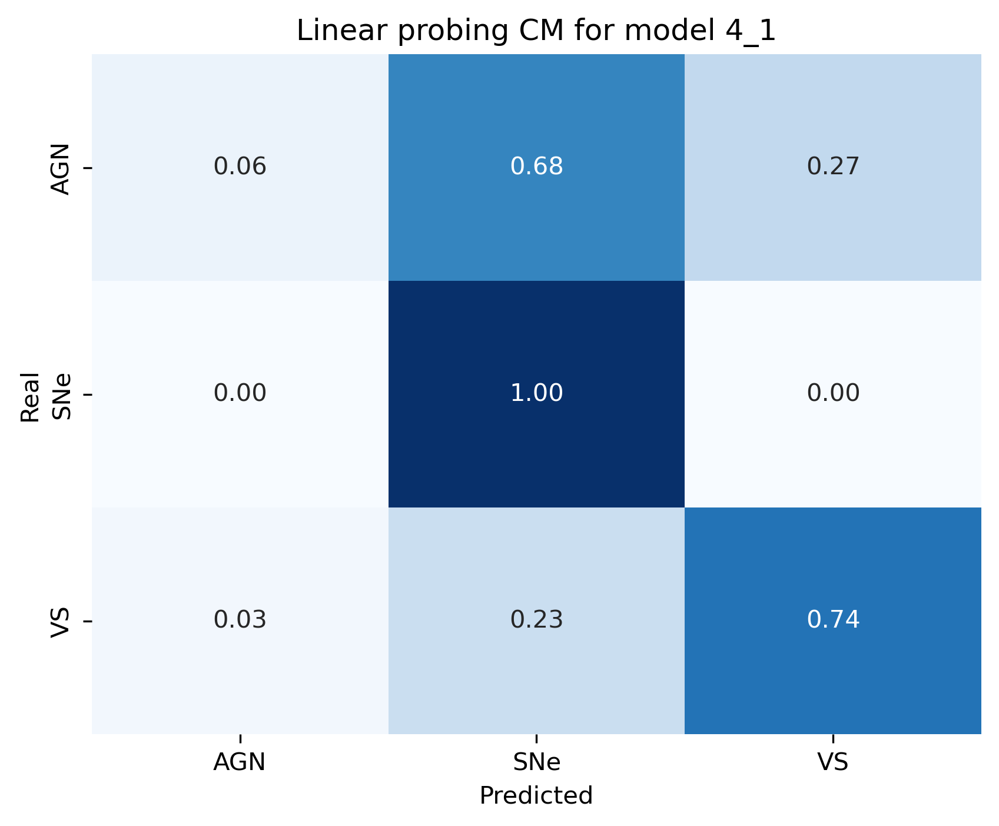

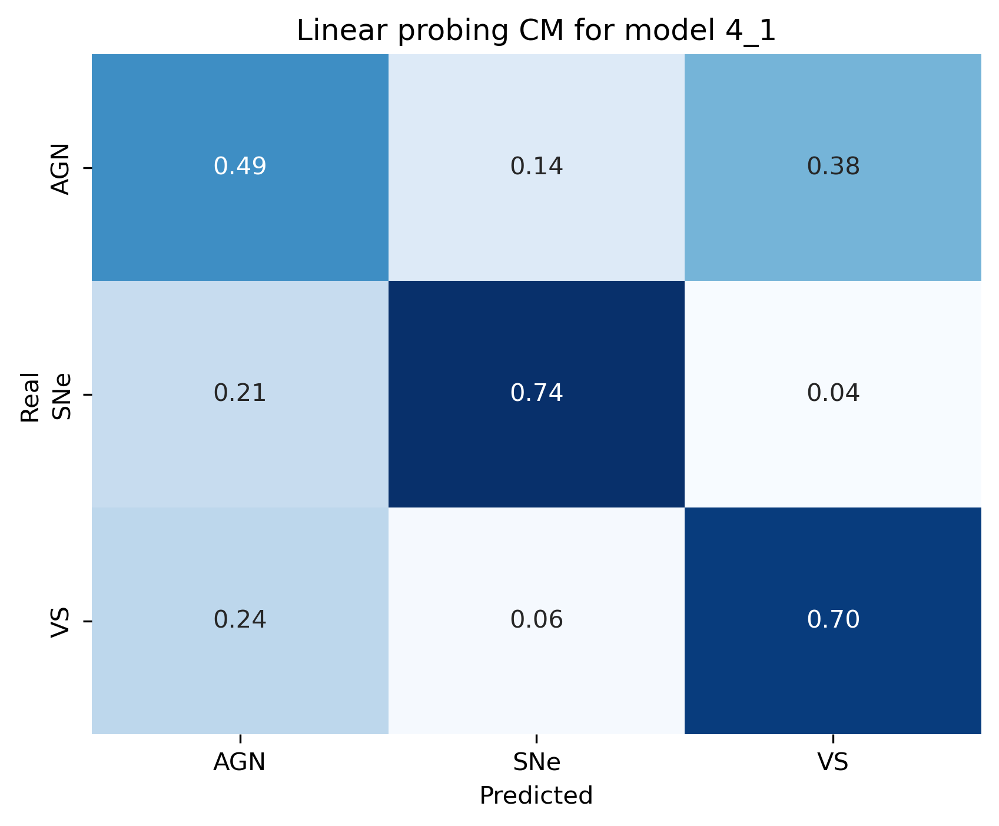

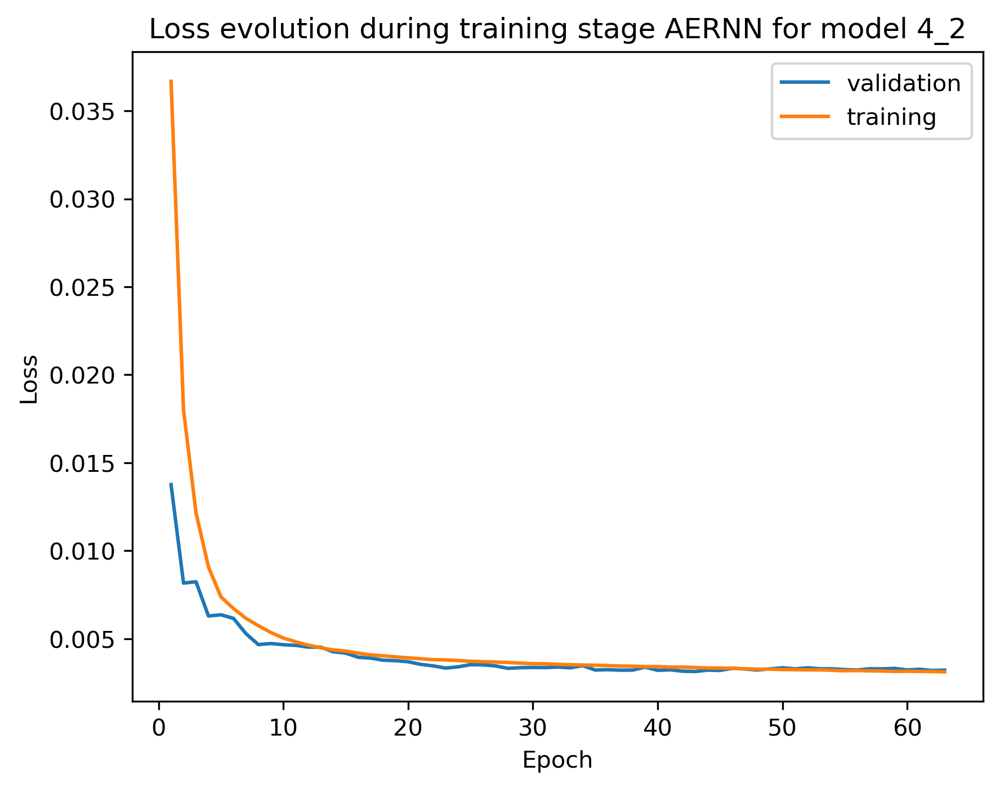

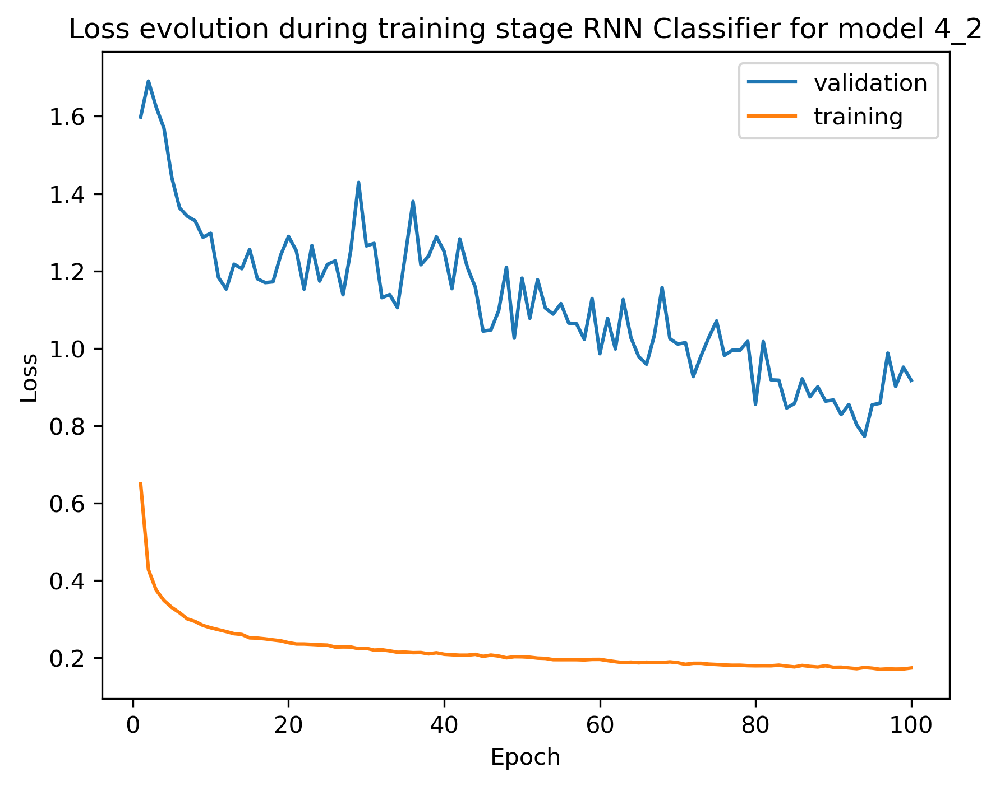

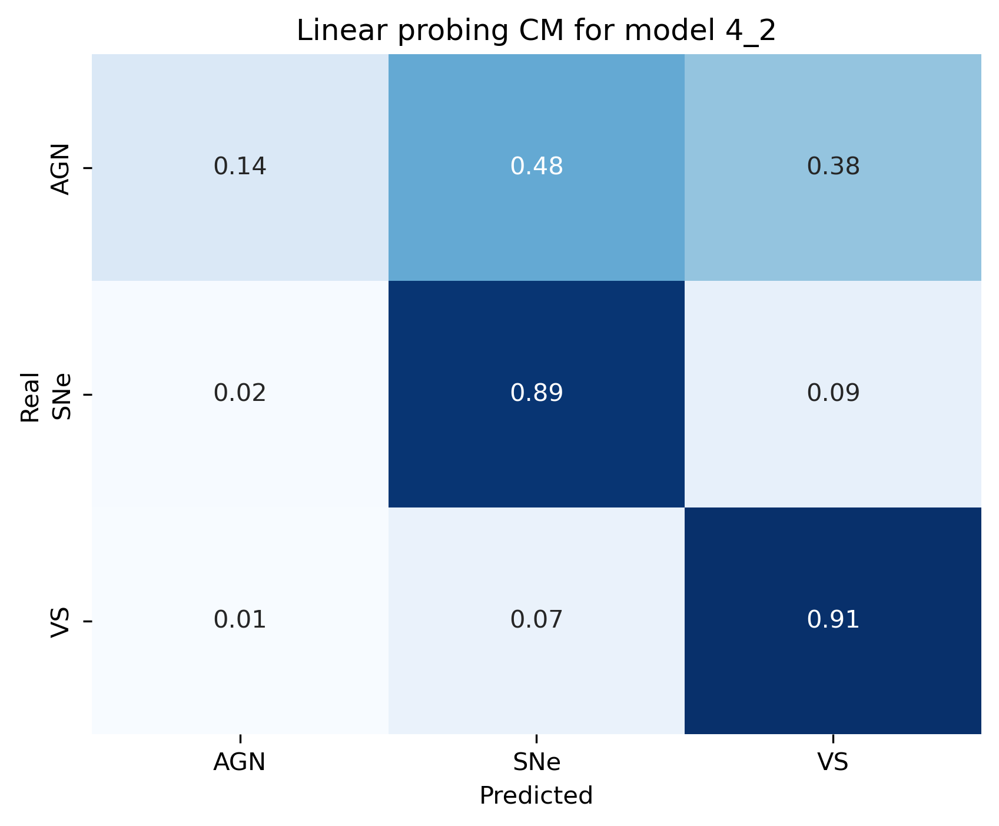

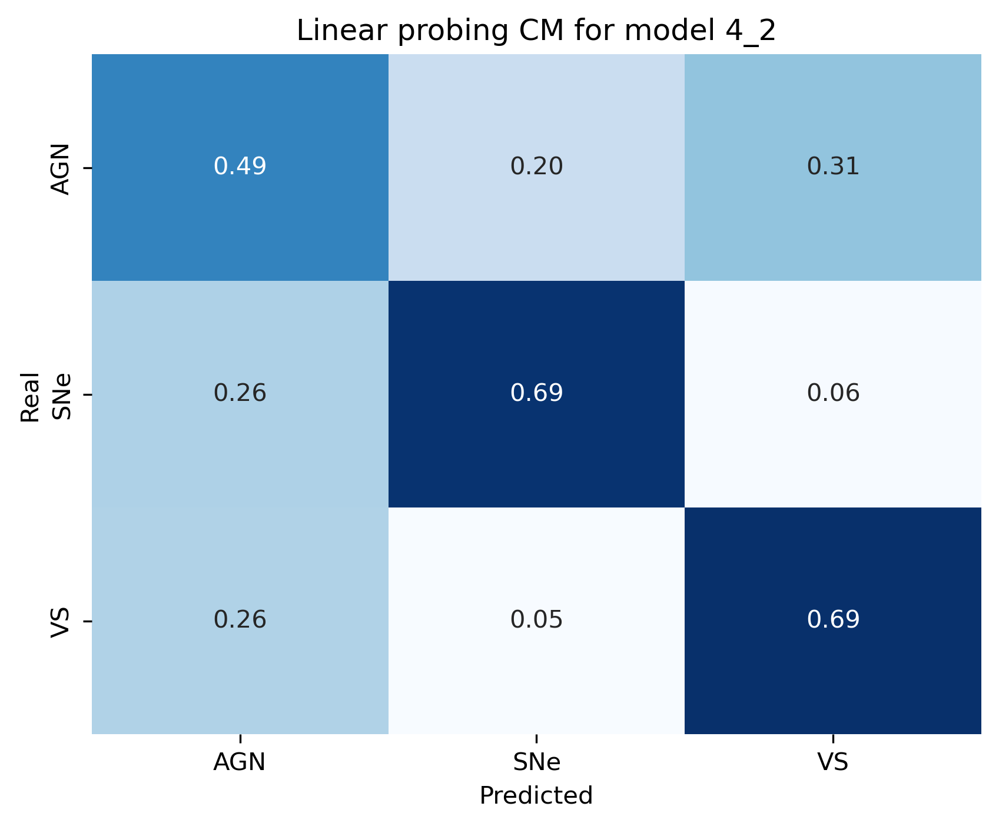

In [25]:
i=1
best_rnn = ('0_0', best_batch[1], 'LSTM')
for exp in experimentos_4:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_4)})\n")
    

    # ----- Entrenamiento de MLP
    curves_ae = ft.train_final_model(modelo,
                                                    'ae_rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_ae'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_rnn[1]:
        best_rnn = (modelo.name, precision_test, exp['rnn_type'])

    with open(file_path, 'a') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

experimentos_5 = [{'iteration' : '5_2', 'rnn_type' : best_rnn[2], 'hidden_dim' : best_lat[2], 'num_layers' : 2, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '5_3', 'rnn_type' : best_rnn[2], 'hidden_dim' : best_lat[2], 'num_layers' : 3, 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.35, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]    
                   

plt.clf

Realizando experimento 5_2 (1/2)


Setup finishied. Starting training...
(0.01 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.10397457  - Train acc: -0.0000 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.09174096  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.08252597  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.07624860  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.07175495  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.06854560  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.06587714  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train

<function matplotlib.pyplot.clf() -> 'None'>

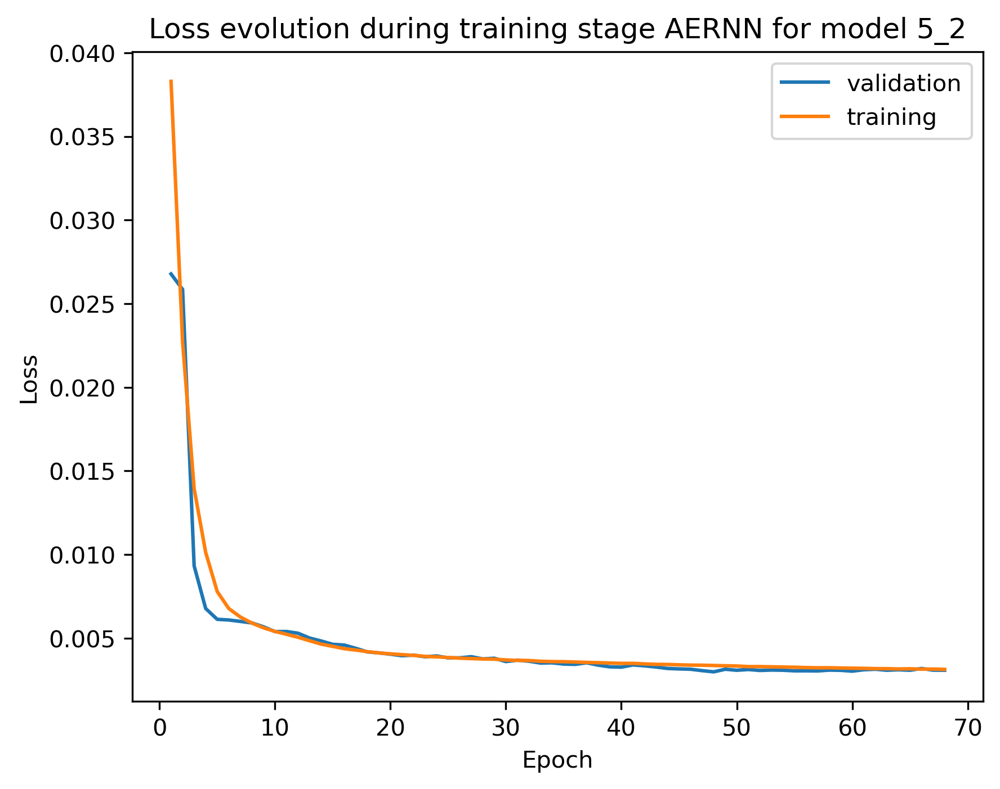

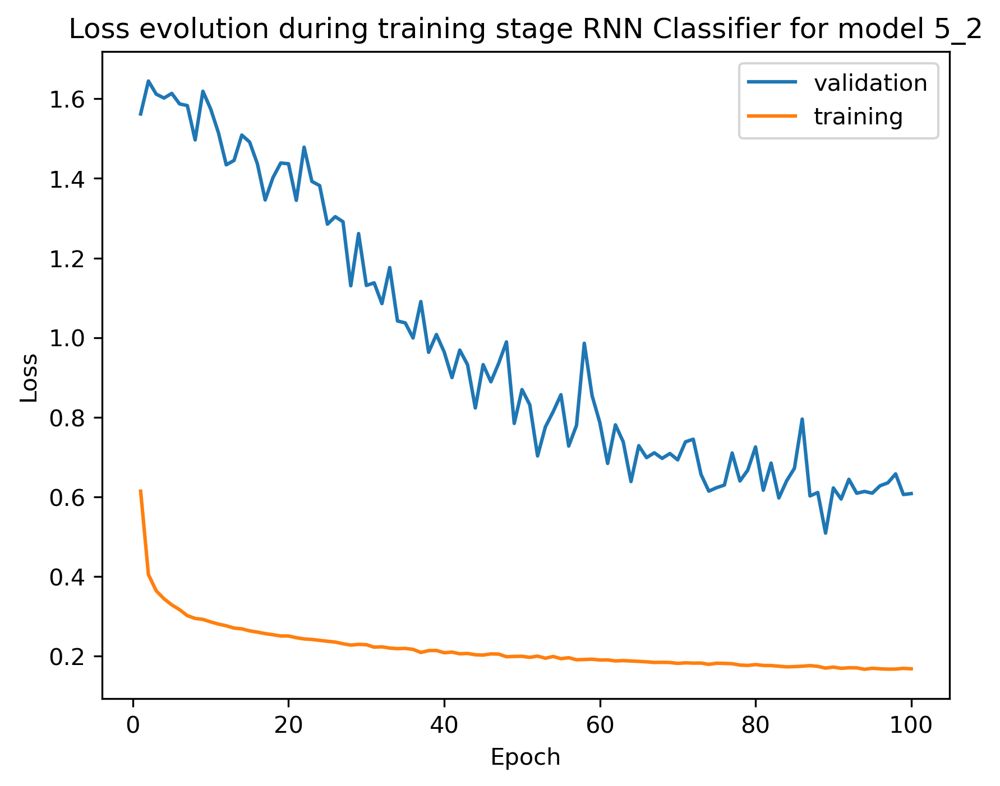

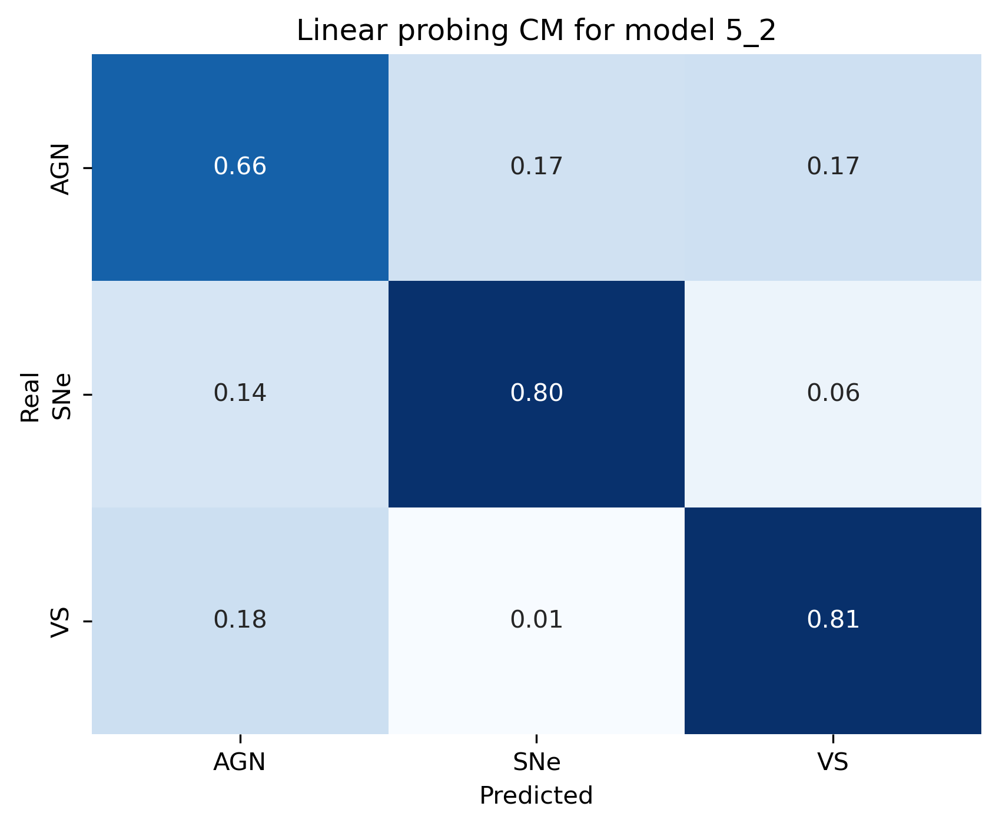

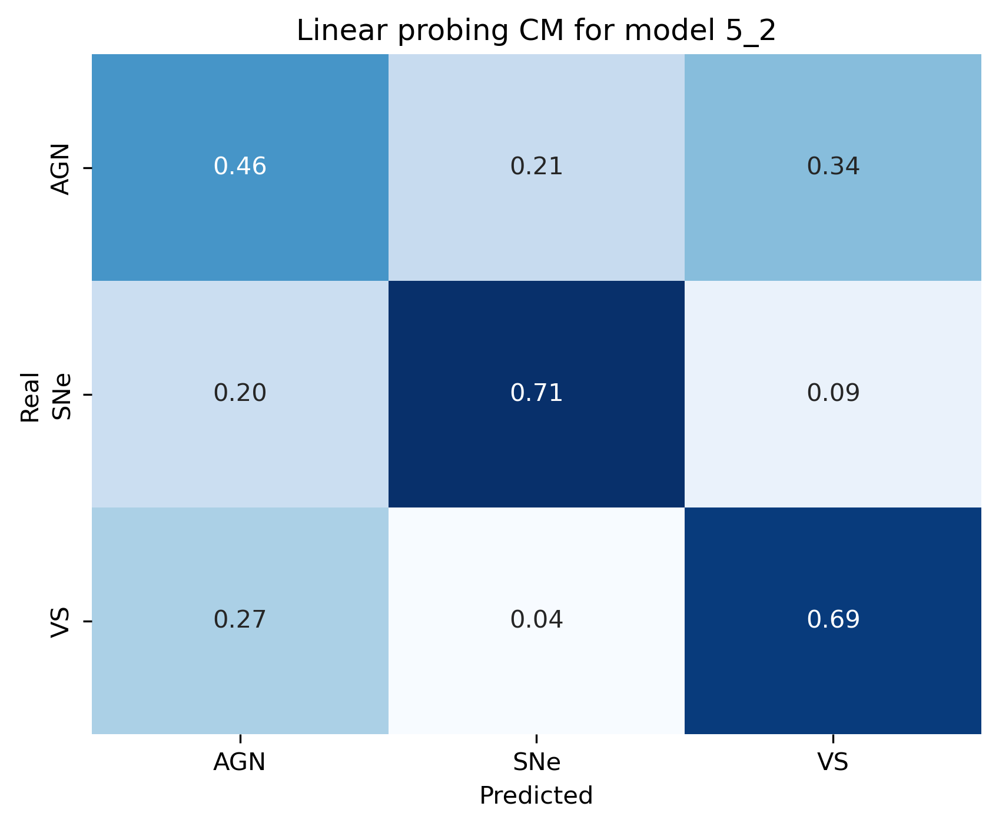

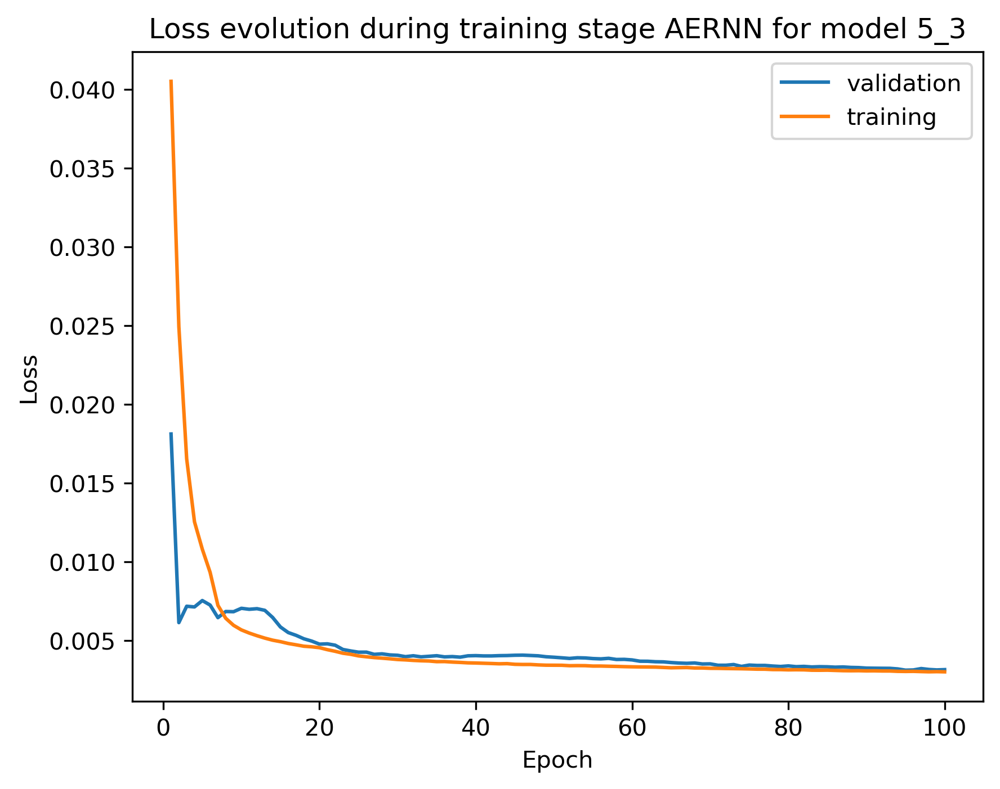

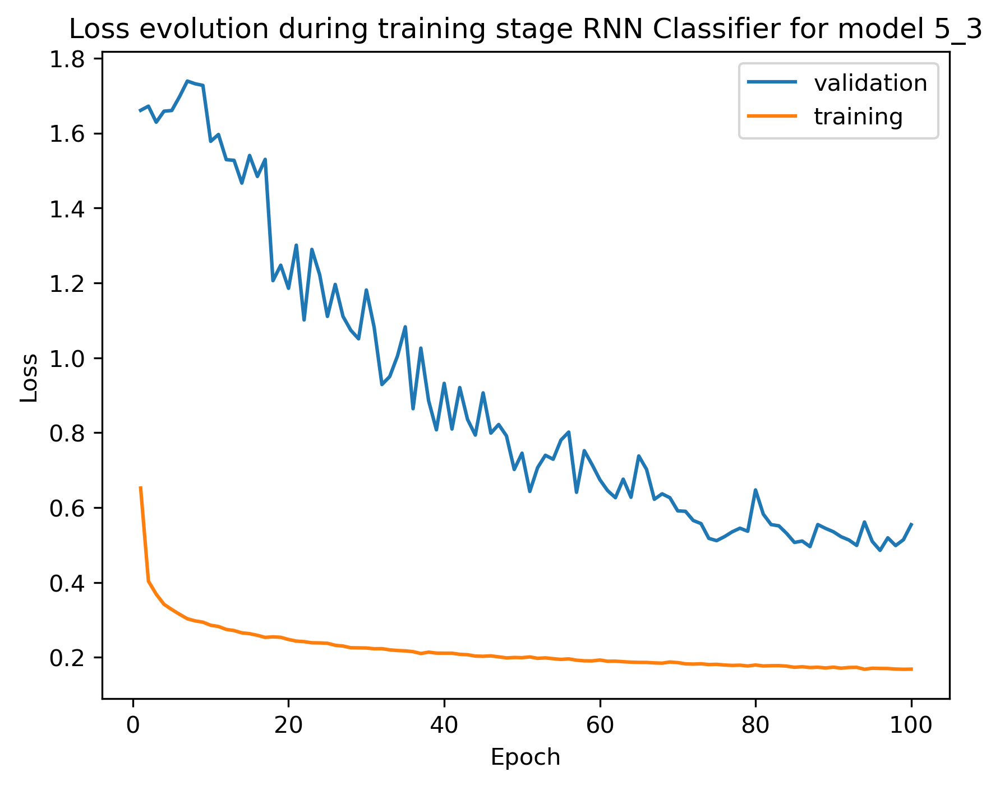

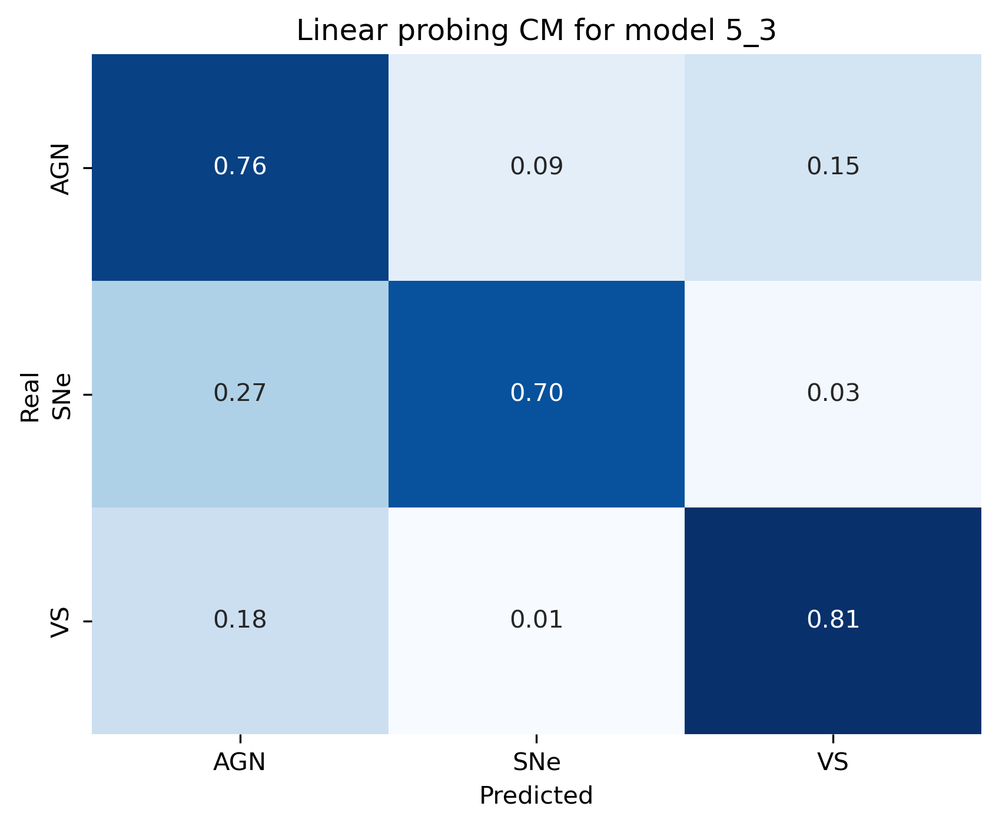

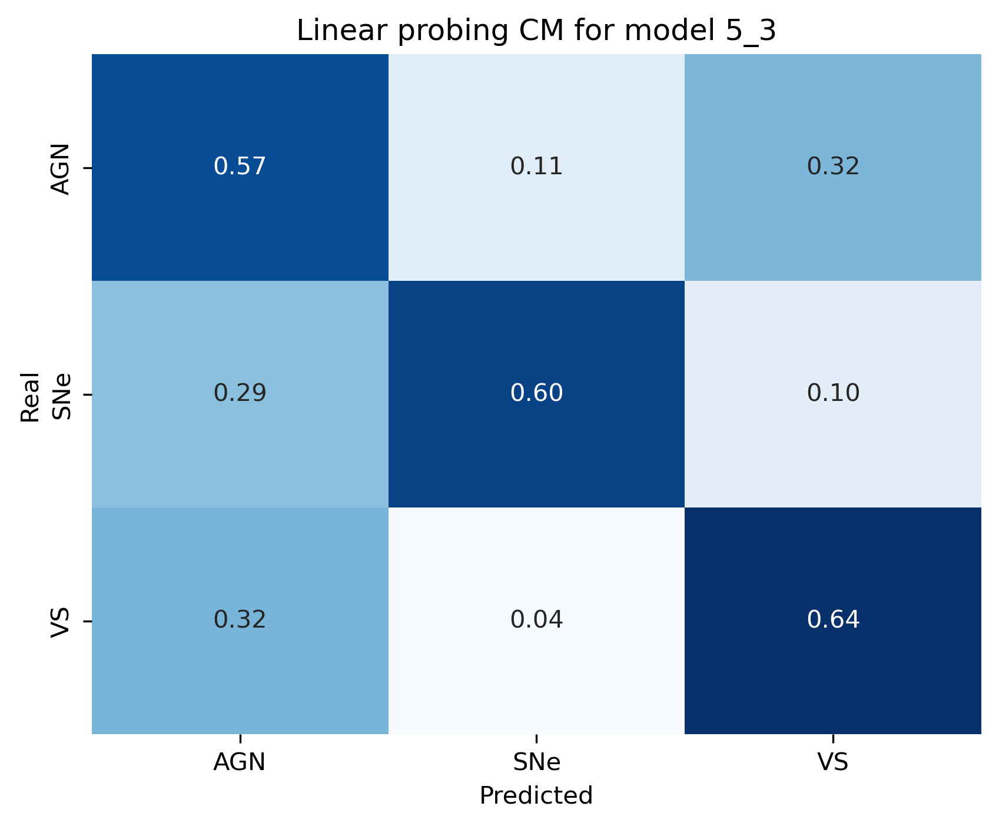

In [26]:
i=1
best_lay = ('0_0', best_rnn[1], 1)
for exp in experimentos_5:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_5)})\n")
    

    # ----- Entrenamiento de MLP
    curves_ae = ft.train_final_model(modelo,
                                                    'ae_rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_ae'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_lay[1]:
        best_lay = (modelo.name, precision_test, exp['num_layers'])

    with open(file_path, 'a') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

experimentos_6 = [{'iteration' : '6_1', 'rnn_type' : best_rnn[2], 'hidden_dim' : best_lat[2], 'num_layers' : best_lay[2], 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.1,
                'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '6_3', 'rnn_type' : best_rnn[2], 'hidden_dim' : best_lat[2], 'num_layers' : best_lay[2], 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.5, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20},
                {'iteration' : '6_4', 'rnn_type' : best_rnn[2], 'hidden_dim' : best_lat[2], 'num_layers' : best_lay[2], 'latent_dim' : best_lat[2], 'max_epochs' : 100, 'max_time' : 120, 'lr_ae' : best_lr[2], 'lr_rnn' : best_lr_rnn[2], 'batch_size' : best_batch[2], 'dropout' : 0.7, 'random_sampler' : True, 'use_gpu' : True, 'only_classifier' : False, 'early_stop' : 20}]       

plt.clf

Realizando experimento 6_1 (1/3)


Setup finishied. Starting training...
(0.01 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.04947010  - Train acc: -0.0000 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.04590717  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.04396864  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.04281297  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.04191855  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.04099600  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.04023871  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train

c:\Users\pmarc\.conda\envs\inteli_gpu\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Realizando experimento 6_4 (1/3)


Setup finishied. Starting training...
(0.01 min) Epoch 1/100 -- Iteration 9 - Batch 9/963 - Train loss: 0.22713040  - Train acc: -0.0000 - Val loss: 0.00000000
(0.01 min) Epoch 1/100 -- Iteration 18 - Batch 18/963 - Train loss: 0.21228411  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 27 - Batch 27/963 - Train loss: 0.19946529  - Train acc: -0.0000 - Val loss: 0.00000000
(0.02 min) Epoch 1/100 -- Iteration 36 - Batch 36/963 - Train loss: 0.18789487  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 45 - Batch 45/963 - Train loss: 0.17796195  - Train acc: -0.0000 - Val loss: 0.00000000
(0.03 min) Epoch 1/100 -- Iteration 54 - Batch 54/963 - Train loss: 0.16906721  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 63 - Batch 63/963 - Train loss: 0.16134566  - Train acc: -0.0000 - Val loss: 0.00000000
(0.04 min) Epoch 1/100 -- Iteration 72 - Batch 72/963 - Train

c:\Users\pmarc\.conda\envs\inteli_gpu\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


<function matplotlib.pyplot.clf() -> 'None'>

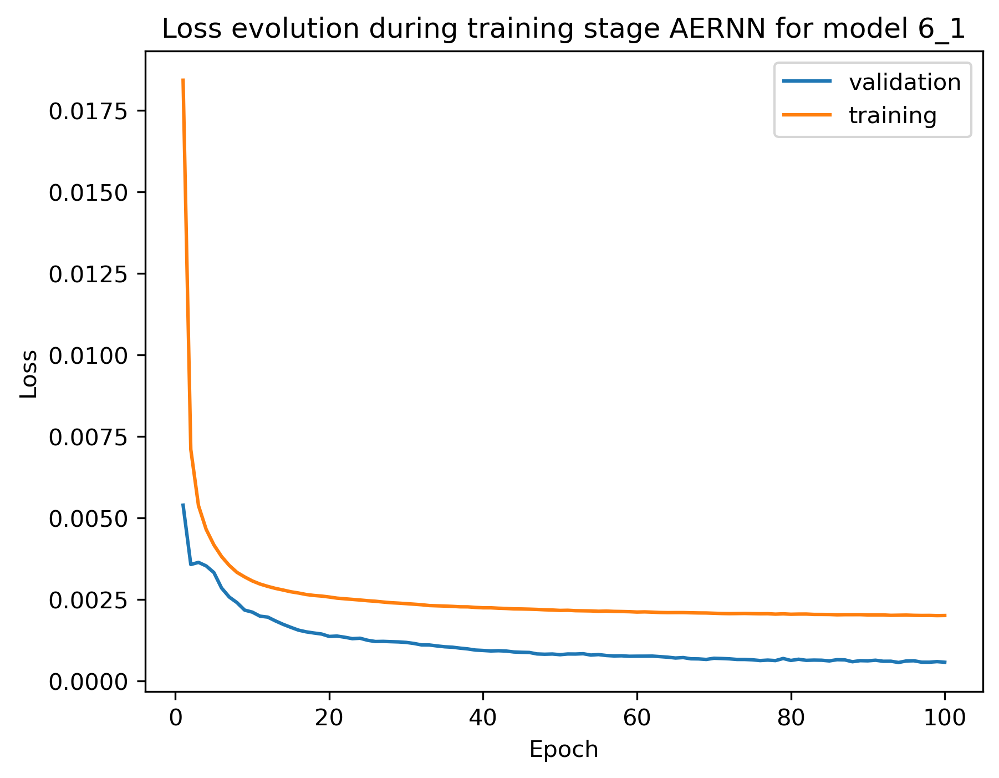

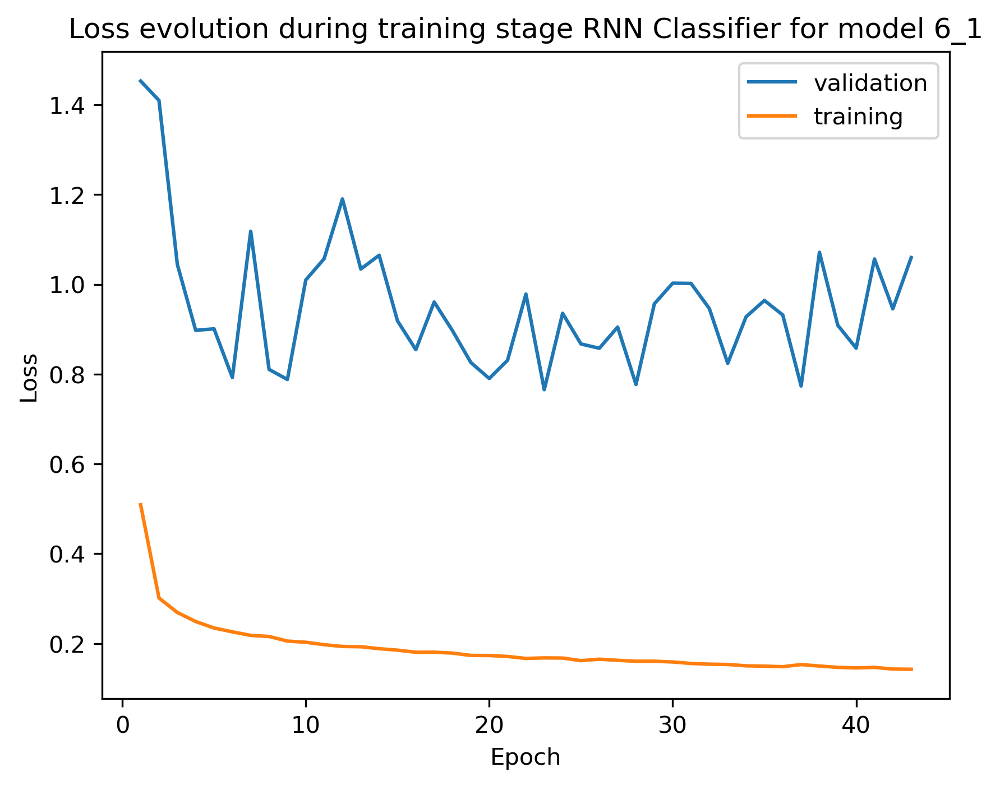

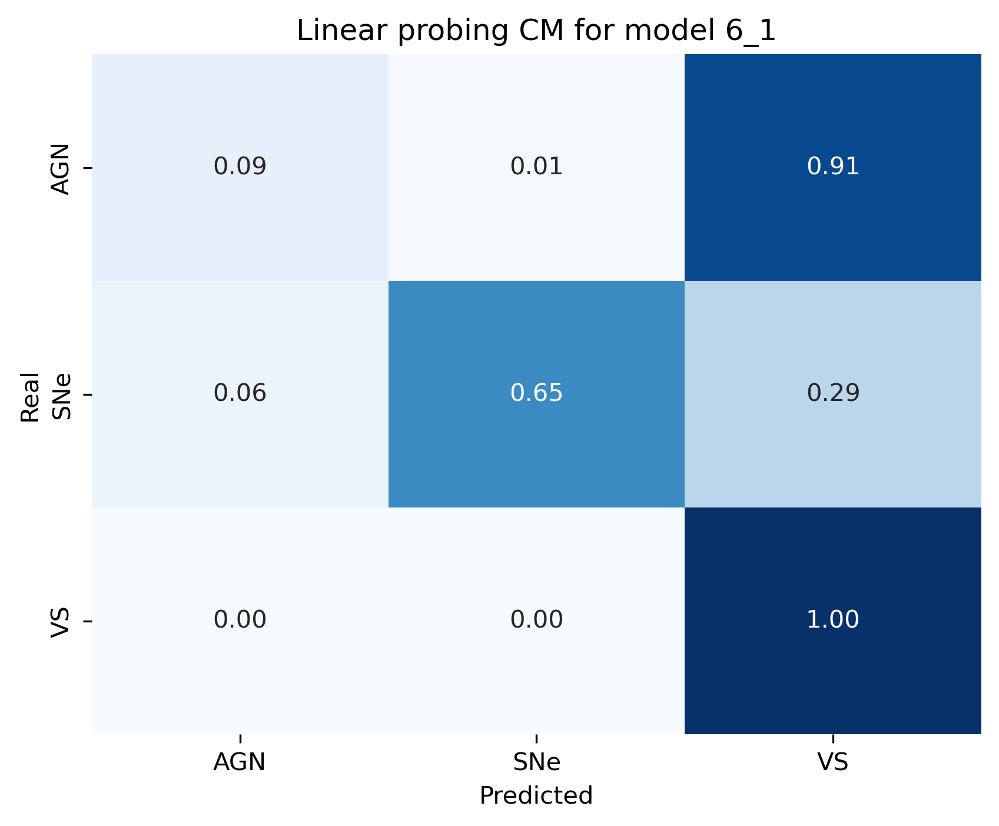

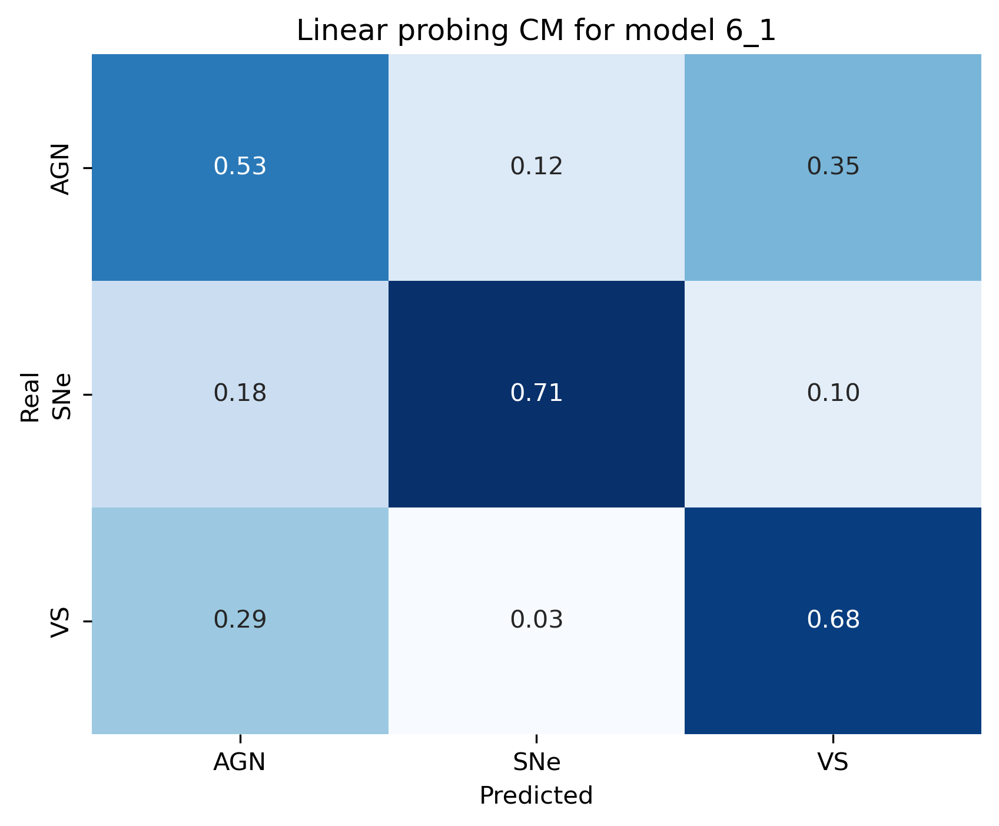

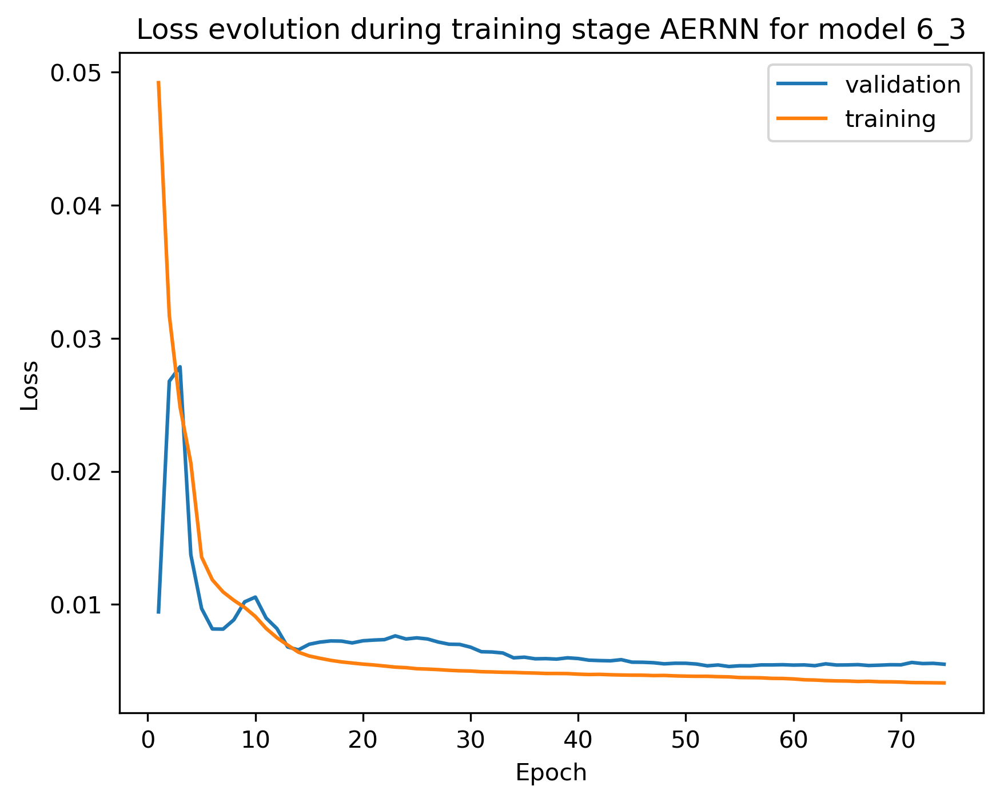

...

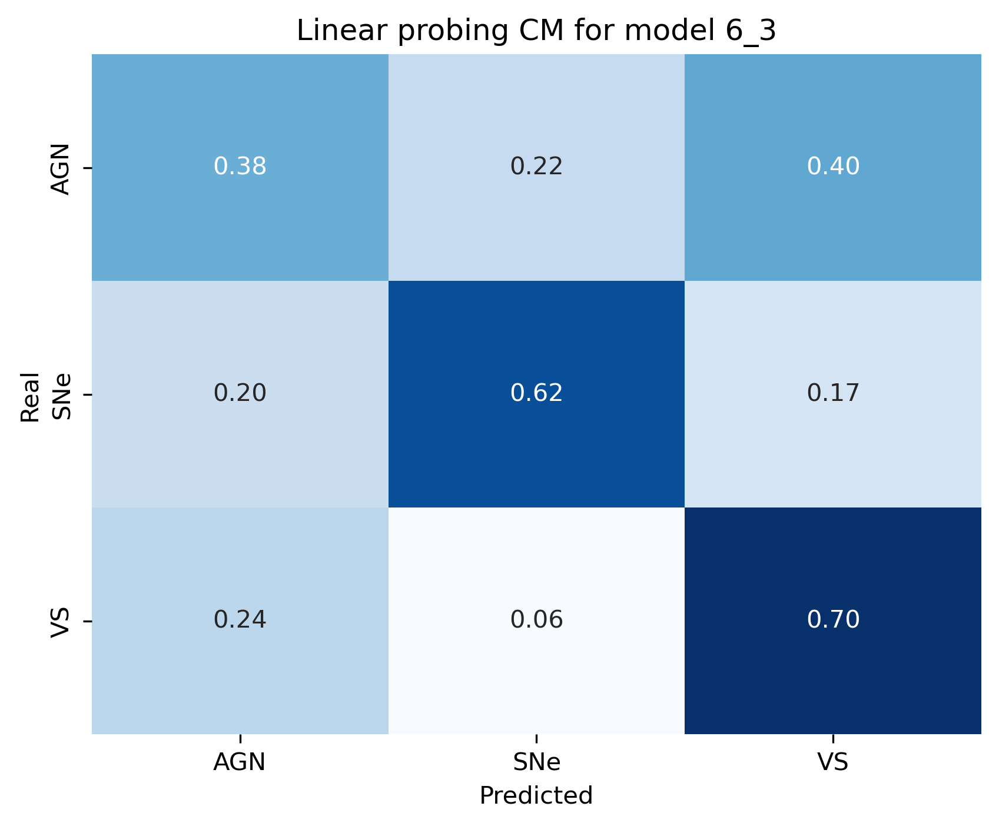

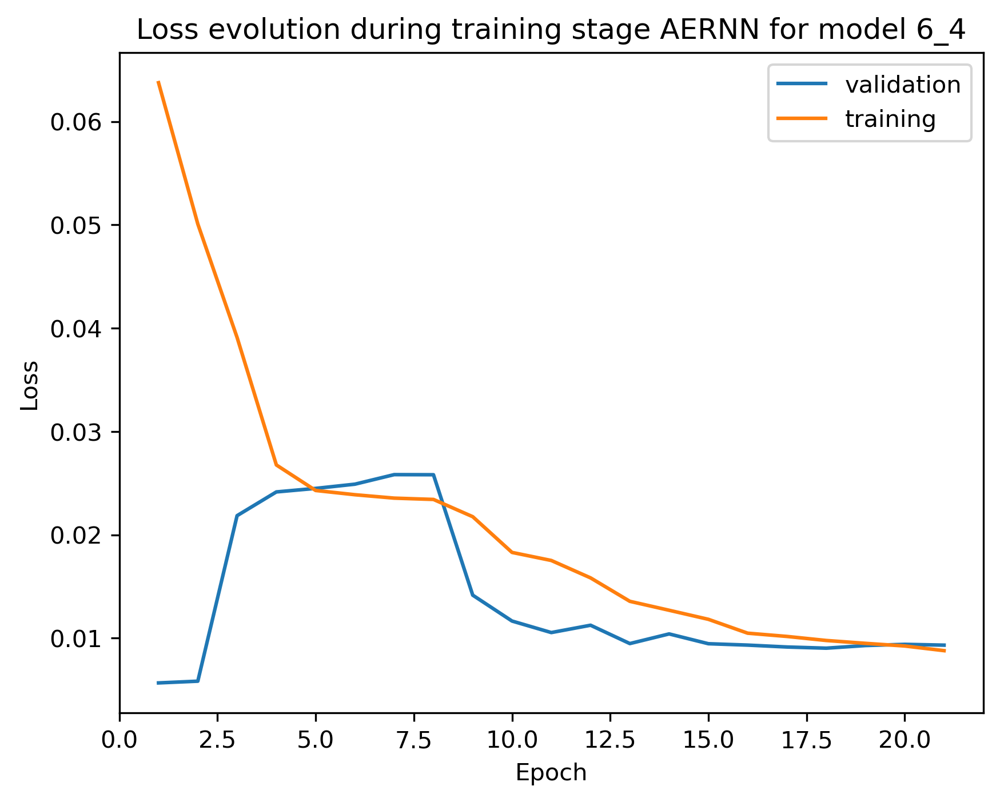

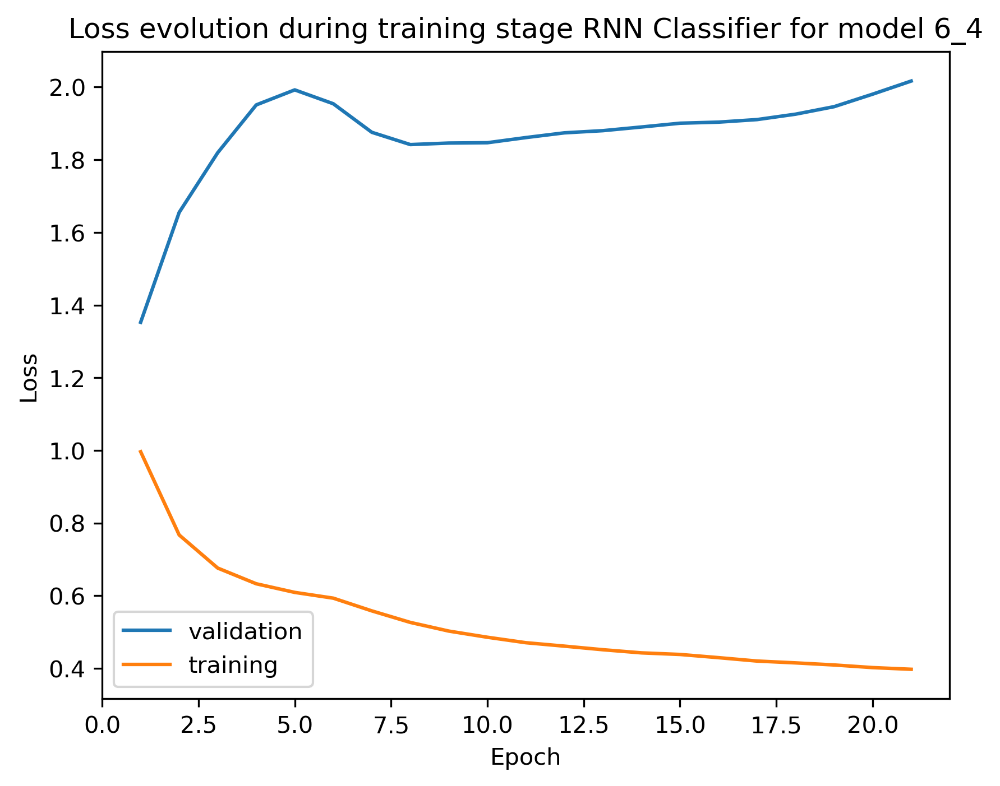

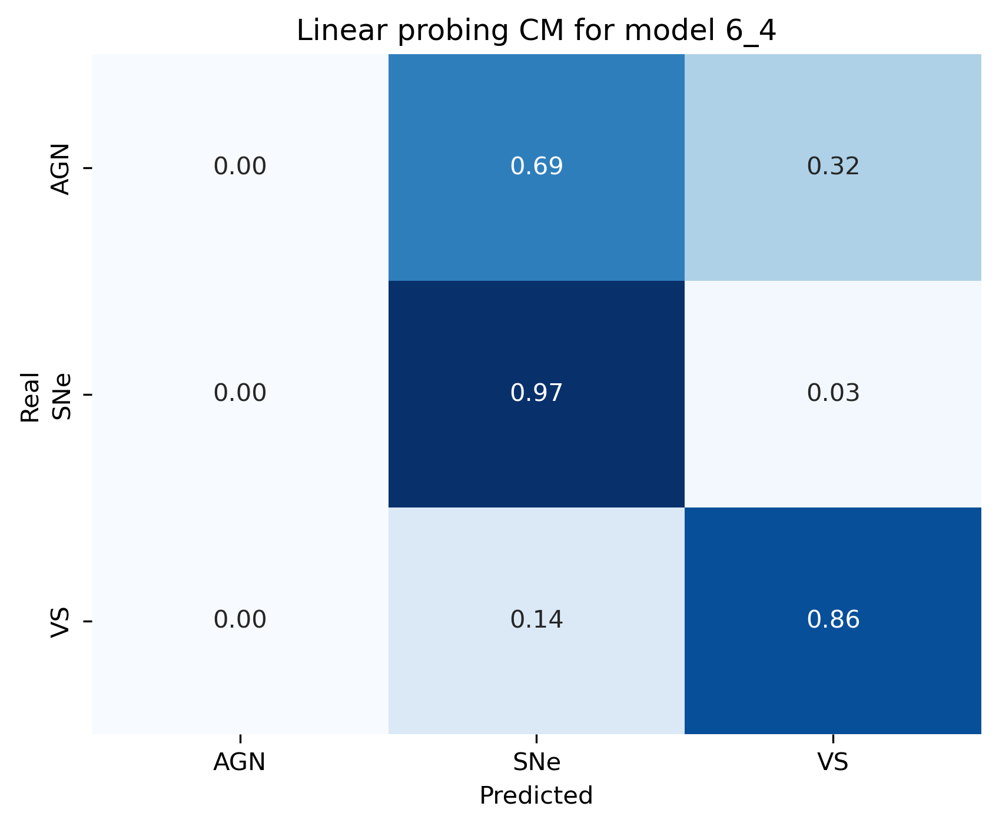

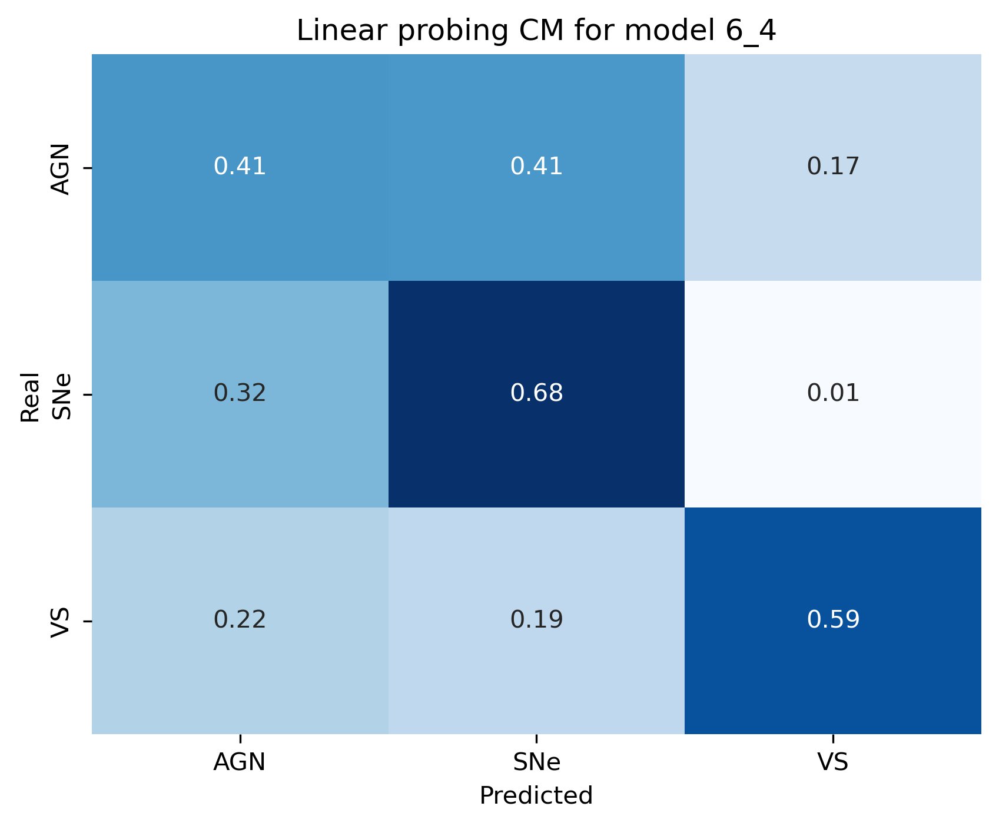

In [27]:
i=1
best_drop = ('0_0', best_lay[1], 0.35)
for exp in experimentos_6:
    
    modelo = fm.FinalModel(exp['latent_dim'], 3, exp['rnn_type'], exp['hidden_dim'], exp['num_layers'], exp['dropout'],  3, name=exp['iteration'])

    os.makedirs(os.path.join(output_directory, modelo.name), exist_ok=True)

    #comienza el experimento
    print(f"Realizando experimento {exp['iteration']} ({i}/{len(experimentos_6)})\n")
    

    # ----- Entrenamiento de MLP
    curves_ae = ft.train_final_model(modelo,
                                                    'ae_rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_ae'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    curves_rnn = ft.train_final_model(modelo,
                                                    'rnn',
                                                    train_dataset,
                                                    validation_dataset,
                                                    ae_loss,
                                                    rnn_loss,
                                                    exp['max_epochs'],
                                                    exp['max_time'],
                                                    exp['batch_size'],
                                                    exp['lr_rnn'],
                                                    exp['random_sampler'],
                                                    exp['only_classifier'],
                                                    False,
                                                    exp['early_stop'],
                                                    exp['use_gpu'],
                                                    0)
    
    torch.save(modelo.state_dict(), f'models/{modelo.name}.pth')
    
    ae_train = metrics.show_curves([curves_ae], [modelo], 'AERNN')
    rnn_train = metrics.show_curves([curves_rnn], [modelo], 'RNN Classifier')

    ae_train.savefig(f'{output_directory}/{modelo.name}/ae_train_{modelo.name}.png')
    rnn_train.savefig(f'{output_directory}/{modelo.name}/rnn_train_{modelo.name}.png')

    modelo.cpu()
    modelo.eval()

    prediction_val = modelo(validation_dataset.tensors[0])
    prediction_test = modelo(test_dataset.tensors[0])

    cm_val = confusion_matrix(validation_dataset.tensors[1], prediction_val.argmax(dim=1), normalize='true')
    print(f'\nCM Validation modelo {modelo.name}')
    cm_test = confusion_matrix(test_dataset.tensors[1], prediction_test.argmax(dim=1), normalize='true')
    print(f'\nCM Test modelo {modelo.name}')

    plot_val = metrics.plot_matrix([modelo], [cm_val])
    plot_val.savefig(f'{output_directory}/{modelo.name}/cm_val_{modelo.name}.png')

    plot_test = metrics.plot_matrix([modelo], [cm_test])
    plot_test.savefig(f'{output_directory}/{modelo.name}/cm_test_{modelo.name}.png')

    precision_val, recall_val, f1_val = metrics.performance_metrics(validation_dataset.tensors[1], prediction_val.argmax(dim=1))
    precision_test, recall_test, f1_test = metrics.performance_metrics(test_dataset.tensors[1], prediction_test.argmax(dim=1))

    if precision_test > best_drop[1]:
        best_drop = (modelo.name, precision_test, exp['dropout'])

    with open(file_path, 'a') as file:
        file.write(f"Experiment {modelo.name}\n")
        file.write(f"   Validation\n")
        file.write(f"       Precision -- {precision_val}\n")
        file.write(f"       Recall    -- {recall_val}\n")
        file.write(f"       F1        -- {f1_val}\n")
        file.write(f"   Test\n")
        file.write(f"       Precision -- {precision_test}\n")
        file.write(f"       Recall    -- {recall_test}\n")
        file.write(f"       F1        -- {f1_test}\n")

plt.clf

In [28]:
print(  f'Best Latent space:          {best_lat[2]}',
        f'\nBest Learning Rate AE:      {best_lr[2]}',
        f'\nBest Learning Rate RNN:     {best_lr_rnn[2]}',
        f'\nBest Batch Size:            {best_batch[2]}',
        f'\nBest RNN Type:              {best_rnn[2]}',
        f'\nBest Number of Layers:      {best_lay[2]}',
        f'\nBest Dropout:               {best_drop[2]}')

Best Latent space:          128 
Best Learning Rate AE:      1e-05 
Best Learning Rate RNN:     1e-05 
Best Batch Size:            128 
Best RNN Type:              LSTM 
Best Number of Layers:      1 
Best Dropout:               0.35
